In [ ]:
pip install albumentations opencv-python-headless matplotlib torch torchvision ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 879.0/879.0 kB 55.4 MB/s eta 0:00:00


In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
from PIL import Image
import pandas as pd
import albumentations as A
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import models, transforms, datasets
from ultralytics import YOLO
import matplotlib.pyplot as plt
from IPython.display import display, Image
from sklearn.metrics import accuracy_score



/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

Using device: cuda


In [ ]:
#This part of the code was done for augmenting the existing dataset into weather based dataset for training the CNN model and later the images were combined into a single folder to train the object detection model
import random

input_dir = '/content/drive/MyDrive/Data/Images' #Input directory containing the images to be augmented
output_dir = '/content/drive/MyDrive/Data/Weather_images' #Output directory where the augmented images need to be stored


os.makedirs(output_dir, exist_ok=True) # If the output directory dosent exist then we create one
train_output_dir = os.path.join(output_dir, 'train')
val_output_dir = os.path.join(output_dir, 'val')
test_output_dir = os.path.join(output_dir, 'test')

os.makedirs(train_output_dir, exist_ok=True)
os.makedirs(val_output_dir, exist_ok=True)
os.makedirs(test_output_dir, exist_ok=True)


def augmentation():  #This fucntion randomly selects an augmentation technique between Rain, Snow, Fog Sun Flare to be applied on an image durin the augmentation process
    augmentations = [
        A.Compose([A.RandomBrightnessContrast(p=1)]),
        A.Compose([A.RandomRain(brightness_coefficient=0.9, drop_width=1, blur_value=3, rain_type="heavy", p=1)]),
        A.Compose([A.RandomSnow(snow_point_lower=0.1, snow_point_upper=0.3, brightness_coeff=2.5, p=1)]),
        A.Compose([A.RandomFog(fog_coef_lower=0.1, fog_coef_upper=0.3, p=1)]),
        A.Compose([A.RandomSunFlare(src_radius=200, num_flare_circles_lower=3, num_flare_circles_upper=6, p=1)])
    ]
    return random.choice(augmentations)

weather_labels = {} #Dictionary to store the weather condition labels for each image so that it would be easier for training the CNN weather classifier

def augment_images(split_name, input_weather_dir, output_weather_dir):
    image_filenames = [f for f in os.listdir(input_weather_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]
    for image_name in tqdm(image_filenames, desc=f"Applying augmentation to {split_name}"):   # This part loops through images, apply random augmentation, and save each image with its label
        image_path = os.path.join(input_weather_dir, image_name)
        image = cv2.imread(image_path)
        if image is None:
            print(f"Error loading image: {image_name}")
            continue
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Convert BGR to RGB for augmentation compatibility
        aug_pipeline = augmentation()   # Get a random weather-based augmentation
        augmented_image = aug_pipeline(image=image)['image']  # Assign a label based on the type of augmentation applied
        condition = "Normal"  # Default condition
        if isinstance(aug_pipeline[0], A.RandomRain):
            condition = "Rainy"
        elif isinstance(aug_pipeline[0], A.RandomSnow):
            condition = "Snowy"
        elif isinstance(aug_pipeline[0], A.RandomFog):
            condition = "Foggy"
        elif isinstance(aug_pipeline[0], A.RandomSunFlare):
            condition = "Sunny"
        weather_labels[image_name] = condition
        weather_dir = os.path.join(output_weather_dir, condition)     # Create directory for each weather condition if it doesn't exist and save the augmented image
        os.makedirs(weather_dir, exist_ok=True)
        if len(augmented_image.shape) == 3 and augmented_image.shape[2] == 3:       # Convert image back to BGR for saving, ensuring proper channel configuration
            augmented_image = cv2.cvtColor(np.array(augmented_image), cv2.COLOR_RGB2BGR)
            augmented_image_path = os.path.join(weather_dir, image_name)
            cv2.imwrite(augmented_image_path, augmented_image)
        else:
            print(f"Skipping image {image_name} due to channel mismatch.")

splits = ['train', 'val', 'test']  # Define dataset splits and apply the augmentations on the images
for split in splits:
    input_weather_dir = os.path.join(input_dir, split)
    output_weather_dir = os.path.join(output_dir, split)
    augment_images(split, input_weather_dir, output_weather_dir)

print('Augmentation completed!')

Applying augmentation to test: 100%|██████████| 16/16 [00:00<00:00, 36.58it/s]

Augmentation completed!


In [ ]:
#This block of code is only used while training the CNN the same for testing is given in the next block and the reviewer can use that if its just for testing
data_transforms = {           # Define image transformations for training, validation, and test sets
    'train': transforms.Compose([
        transforms.Resize((128, 128)),   # Resize images to 128x128 pixels
        transforms.RandomHorizontalFlip(),  # Apply horizontal flip randomly for data augmentation
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = '/content/drive/MyDrive/Data/Weather_images'  # Here we define the main dataset directory and load the images with the applied transformations
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: DataLoader(image_datasets[x], batch_size=32, shuffle=True, num_workers=4)
               for x in ['train', 'val']}
test_loader = DataLoader(image_datasets['test'], batch_size=32, shuffle=False, num_workers=4)


In [ ]:
#This is the same as previous block except that this is used for testing purpose
data_transforms = {
    'test': transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = '/content/drive/MyDrive/Data/Weather_images'
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x])
                  for x in ['test']}
test_loader = DataLoader(image_datasets['test'], batch_size=32, shuffle=False, num_workers=4)


In [ ]:
#This is the CNN weather classifier structure
class WeatherCNN(nn.Module):
    def __init__(self, num_classes=5): # Initialize the CNN with 5 weather condition classes
        super(WeatherCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1), # First conv layer with 64 filters
            nn.ReLU(), # Apply ReLU activation
            nn.MaxPool2d(2, 2), # Reduce spatial dimensions by half
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)
        )
       # Here we define the fully connected layers for classification
        self.classifier = nn.Sequential(
            nn.Dropout(0.5), # Applying dropout to reduce overfitting
            nn.Linear(512 * 8 * 8, 1024), # First fully connected layer with 1024 neurons
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(1024, num_classes) # Final layer for outputting class scores
        )

    def forward(self, x):
        x = self.features(x) # Passing the input through feature extraction layers
        x = x.view(x.size(0), -1)
        x = self.classifier(x) # Passing through classifier layers to get class predictions
        return x

model = WeatherCNN(num_classes=5).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [ ]:
#This block of code is for Training the CNN model

def train(model, criterion, optimizer, num_epochs=25):
    for epoch in range(num_epochs):
        print(f"Epoch {epoch + 1}/{num_epochs}")
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train() # Setting model to training mode
            else:
                model.eval() # Setting model to evaluation mode

            running_loss = 0.0
            running_corrects = 0
            for inputs, labels in dataloaders[phase]: # Loop over data batches
                inputs, labels = inputs.to(device), labels.to(device)
                optimizer.zero_grad() # Reset gradients
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                running_loss += loss.item() * inputs.size(0) # Update running statistics
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(image_datasets[phase])  # Calculate epoch statistics
            epoch_acc = running_corrects.double() / len(image_datasets[phase])
            print(f"{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}")
train(model, criterion, optimizer, num_epochs=25) # Train the model over 25 epochs


Epoch 1/25
train Loss: 1.2426 Acc: 0.4692
val Loss: 0.8615 Acc: 0.6423
Epoch 2/25
train Loss: 0.7329 Acc: 0.6863
val Loss: 0.5556 Acc: 0.7176
Epoch 3/25
train Loss: 0.5989 Acc: 0.7380
val Loss: 0.5636 Acc: 0.7254
Epoch 4/25
train Loss: 0.5367 Acc: 0.7557
val Loss: 0.4949 Acc: 0.7398
Epoch 5/25
train Loss: 0.5363 Acc: 0.7644
val Loss: 0.4504 Acc: 0.7907
Epoch 6/25
train Loss: 0.5074 Acc: 0.7752
val Loss: 0.4596 Acc: 0.7741
Epoch 7/25
train Loss: 0.4817 Acc: 0.7880
val Loss: 0.5605 Acc: 0.7497
Epoch 8/25
train Loss: 0.4660 Acc: 0.7970
val Loss: 0.4148 Acc: 0.8073
Epoch 9/25
train Loss: 0.4444 Acc: 0.8018
val Loss: 0.4094 Acc: 0.7984
Epoch 10/25
train Loss: 0.4310 Acc: 0.8163
val Loss: 0.4153 Acc: 0.7996
Epoch 11/25
train Loss: 0.4040 Acc: 0.8241
val Loss: 0.4460 Acc: 0.8151
Epoch 12/25
train Loss: 0.4021 Acc: 0.8296
val Loss: 0.4073 Acc: 0.8162
Epoch 13/25
train Loss: 0.3865 Acc: 0.8395
val Loss: 0.4470 Acc: 0.7885
Epoch 14/25
train Loss: 0.3637 Acc: 0.8471
val Loss: 0.4743 Acc: 0.8018
E

In [ ]:
#Here we are saving the trained model
torch.save(model.state_dict(), '/content/drive/MyDrive/AI-P-checkpoint/cnn_weather_classifier.pth')

In [ ]:
weather_model = WeatherCNN().to(device)
weather_model.load_state_dict(torch.load('/content/drive/MyDrive/AI-P-checkpoint/cnn_weather_classifier.pth')) # Load model weights from file
weather_model.eval() # Set model to evaluation mode to prevent training updates during testing

WeatherCNN(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU()
    (8): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (9): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=32768, out_features=1024, bias=True)
    (2): ReLU()
    (3): Dropout(p=0.5, inplace=False)
    (4): Linear(in_features=1024, out_features=5, bias=True)
  )


In [ ]:
test_dataset = datasets.ImageFolder(root='/content/drive/MyDrive/Data/Weather_images/test') # Loading the test dataset from the specified directory and retrieving class names
class_names = test_dataset.classes
print(class_names)  # Print the class names to verify correct labels

['Foggy', 'Normal', 'Rainy', 'Snowy', 'Sunny']


In [ ]:
#This function is to evaluate the CNN model on the test dataset
def evaluate(weather_model, test_dataset, class_names):
    weather_model.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad(): # Disabling the gradient calculation for faster evaluation
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs) # Get model's predictions
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            for i in range(inputs.size(0)): # Print predictions for each image in the batch
                image_name = test_loader.dataset.samples[i][0].split('/')[-1]
                predicted_class = class_names[preds[i].item()]
                print(f"Image: {image_name}, Predicted Class: {predicted_class}")


In [ ]:
#These are the different weather based filters necessary for filtering the images for further object detection
import cv2
import numpy as np
from typing import Union

def validate_image(image: np.ndarray) -> None:  # This function is to check if the input is a valid BGR image with 3 color channels
    """Validates that the input is a BGR image with 3 channels."""
    if image is None or len(image.shape) != 3 or image.shape[2] != 3:
        raise ValueError("Input must be a BGR image with 3 channels.")

def dehaze(image: np.ndarray) -> np.ndarray: #This function is to dehaze an image for clearer visibility, useful for foggy or hazy conditions
    """Enhances image clarity by performing histogram equalization on the value channel of HSV."""
    validate_image(image)
    image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)  # Convert to HSV color space
    value_channel = image_hsv[:, :, 2] # Extract the value channel
    dehazed_value_channel = cv2.equalizeHist(value_channel) # Applying histogram equalization to the value channel
    image_hsv[:, :, 2] = dehazed_value_channel # Update the value channel in HSV image
    return cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR) # Converting back to BGR format

def enhance_low_light(image: np.ndarray) -> np.ndarray: # This function is to enhance low-light images, improving visibility in dim lighting
    """Enhances low-light images using CLAHE on the LAB color space."""
    validate_image(image)
    lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)  # Converting the image to LAB color space
    l, a, b = cv2.split(lab_image) # Splitting it into L, A, and B channels
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8)) # Initializing CLAHE for contrast enhancement
    l_clahe = clahe.apply(l) # Apply CLAHE to the L channel
    lab_clahe = cv2.merge((l_clahe, a, b)) #Merge the channels back
    return cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)

def remove_glare(image: np.ndarray) -> np.ndarray:  # This function is to remove any glare by inpainting over bright spots in the image
    """Removes glare from the image by inpainting bright spots."""
    validate_image(image)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    bright_spots = cv2.inRange(gray, 240, 255) # Detecting the bright areas that are likely to cause a glare
    kernel = np.ones((5, 5), np.uint8) # Define a kernel for dilation
    bright_spots = cv2.dilate(bright_spots, kernel, iterations=2)  # Dilate to cover glare areas fully
    return cv2.inpaint(image, bright_spots, 3, cv2.INPAINT_TELEA)

def enhance_contrast(image: np.ndarray) -> np.ndarray: # This function is to improve image contrast, especially useful for low-contrast conditions
    """Enhances the contrast of the image using histogram equalization on the LAB color space."""
    validate_image(image)
    lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab_image)
    l_eq = cv2.equalizeHist(l)
    lab_eq = cv2.merge((l_eq, a, b))
    return cv2.cvtColor(lab_eq, cv2.COLOR_LAB2BGR)

In [ ]:
def apply_dip(image: np.ndarray, weather_class: int) -> np.ndarray:
    """Applies appropriate image enhancement based on detected weather conditions."""
    validate_image(image)
    # Here the enhancement is choosen based on the weather class
    if weather_class in [1, 2]:
        return dehaze(image)
    elif weather_class == 3:
        enhanced_image = enhance_low_light(image)
        return enhance_contrast(enhanced_image)
    elif weather_class == 4:
        return enhance_low_light(image)
    else:
        return image

In [ ]:
#This block of code was useed only to create a yaml file for YOLOv8 training
dataset_path ='/content/drive/MyDrive/Data/images'
yaml_content = """
path: {dataset_path}  # Root directory of the dataset
train: /content/drive/MyDrive/Data/images/train       # Training images folder relative to `path`
val: /content/drive/MyDrive/Data/images/val           # Validation images folder relative to `path`
test: /content/drive/MyDrive/Data/images/test         # Optional: Testing images folder relative to `path`

nc: 20                     # Number of classes
names: ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle',
        'bus', 'car', 'cat', 'chair', 'cow',
        'diningtable', 'dog', 'horse', 'motorbike', 'person',
        'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']  # List your class names here
""".format(dataset_path=dataset_path)
with open(f"{dataset_path}/dataset.yaml", "w") as yaml_file:
    yaml_file.write(yaml_content)


In [ ]:
#This block of code is used only for training the YOLOv8 model
model = YOLO('yolov8m.pt')
dataset_yaml = '/content/drive/MyDrive/Data/images/dataset.yaml'
model.train(data=dataset_yaml, epochs=35, batch=16, imgsz=640)
results = model.val()
model.save('/content/drive/MyDrive/AI-P-checkpoint/yolov8_weather_model.pt')
print('YOLOv8 training complete.')

100%|██████████| 49.7M/49.7M [00:00<00:00, 257MB/s]


Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/Data/images/dataset.yaml, epochs=35, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_label

100%|██████████| 755k/755k [00:00<00:00, 13.3MB/s]


Overriding model.yaml nc=80 with nc=20

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 54.8MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Data/labels/train... 17125 images, 0 backgrounds, 0 corrupt: 100%|██████████| 17125/17125 [12:35<00:00, 22.65it/s]


train: New cache created: /content/drive/MyDrive/Data/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/Data/labels/val.cache... 893 images, 10 backgrounds, 0 corrupt: 100%|██████████| 903/903 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 35 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/35       7.4G     0.9478      1.592      1.286         12        640: 100%|██████████| 1071/1071 [02:45<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:06<00:00,  4.70it/s]

                   all        903       1186      0.678      0.701      0.706      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/35      7.46G      1.103      1.639      1.419         14        640: 100%|██████████| 1071/1071 [02:27<00:00,  7.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.36it/s]

                   all        903       1186      0.651      0.732      0.705      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/35      7.43G      1.142      1.714      1.449         30        640: 100%|██████████| 1071/1071 [02:23<00:00,  7.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.14it/s]

                   all        903       1186      0.662      0.751      0.722      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/35      7.34G      1.129      1.664      1.439         35        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.39it/s]

                   all        903       1186      0.723      0.679      0.721      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/35      7.44G      1.079      1.565      1.409         13        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.54it/s]


                   all        903       1186      0.728      0.763      0.775      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/35      7.42G      1.046      1.479      1.382         14        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.64it/s]

                   all        903       1186       0.71      0.775       0.77      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/35      7.47G      1.013      1.415      1.359         18        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.66it/s]

                   all        903       1186      0.736      0.751      0.775      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/35      7.35G     0.9982      1.367       1.35         23        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.54it/s]

                   all        903       1186      0.709        0.8      0.786      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/35      7.45G     0.9783      1.323      1.331         19        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.32it/s]

                   all        903       1186      0.732      0.804      0.815      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/35      7.46G     0.9587      1.285      1.317         28        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.55it/s]


                   all        903       1186      0.762      0.789      0.824      0.648

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/35      7.46G     0.9377      1.237        1.3         32        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.86it/s]


                   all        903       1186      0.748       0.82      0.836      0.659

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/35      7.34G     0.9272      1.207      1.288         27        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.65it/s]

                   all        903       1186      0.771      0.801      0.841      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/35      7.43G     0.9195      1.177      1.284         36        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.47it/s]

                   all        903       1186       0.73      0.835      0.838      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/35       7.4G     0.8961      1.144      1.271         30        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.41it/s]

                   all        903       1186      0.759      0.782      0.842      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/35      7.44G     0.8939      1.117      1.264         29        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.61it/s]

                   all        903       1186      0.764      0.828      0.857      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/35      7.36G     0.8743      1.079       1.25         30        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.65it/s]

                   all        903       1186      0.755      0.837      0.856      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/35      7.41G      0.865      1.054      1.241         35        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.77it/s]


                   all        903       1186      0.781      0.837       0.87      0.711

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/35      7.43G     0.8562      1.026      1.231         31        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.41it/s]

                   all        903       1186       0.76      0.849      0.864      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/35      7.47G     0.8414      1.009      1.223         25        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.43it/s]

                   all        903       1186      0.792      0.834      0.883      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/35      7.39G     0.8299     0.9837      1.217         22        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.55it/s]

                   all        903       1186       0.79      0.829      0.881      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/35      7.44G     0.8167     0.9599      1.206         15        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.85it/s]


                   all        903       1186      0.806      0.815      0.883      0.741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/35      7.42G     0.8026     0.9341      1.197         21        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.83it/s]

                   all        903       1186      0.759       0.86      0.884      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/35       7.5G     0.7927     0.9092      1.189         22        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.76it/s]

                   all        903       1186      0.801      0.833      0.888      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/35      7.36G     0.7849     0.8893      1.181         14        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.45it/s]

                   all        903       1186       0.78      0.855      0.893      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/35      7.42G     0.7771     0.8719      1.177         25        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.37it/s]

                   all        903       1186      0.809      0.863      0.902      0.777


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/35      7.39G     0.7279     0.6987      1.127          9        640: 100%|██████████| 1071/1071 [02:22<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.89it/s]


                   all        903       1186      0.832      0.829      0.901      0.777

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/35      7.46G     0.7108       0.67      1.114         15        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.71it/s]

                   all        903       1186      0.806      0.863      0.908      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/35      7.36G      0.695     0.6444      1.101          7        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.82it/s]


                   all        903       1186      0.823      0.863      0.916      0.791

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/35      7.43G     0.6836     0.6131      1.091         16        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.70it/s]


                   all        903       1186       0.83      0.854      0.911      0.792

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/35      7.41G     0.6694     0.5943      1.083         15        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.35it/s]

                   all        903       1186      0.846      0.844      0.916      0.802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/35      7.43G     0.6543     0.5656      1.069          7        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.34it/s]

                   all        903       1186      0.817      0.885      0.921      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/35      7.31G     0.6465     0.5455      1.062         28        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.56it/s]

                   all        903       1186      0.851      0.866      0.922       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/35      7.41G     0.6286     0.5245      1.048          6        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.82it/s]

                   all        903       1186      0.857      0.865      0.925      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/35       7.4G      0.623      0.506      1.045          5        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.75it/s]


                   all        903       1186      0.855      0.878      0.928       0.82

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/35      7.42G     0.6148     0.4922      1.036         18        640: 100%|██████████| 1071/1071 [02:21<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:04<00:00,  6.72it/s]

                   all        903       1186      0.845      0.893      0.931      0.823



35 epochs completed in 1.447 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25,851,340 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 29/29 [00:05<00:00,  5.40it/s]


                   all        903       1186      0.845      0.893      0.931      0.823
                person        893       1186      0.845      0.893      0.931      0.823
Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25,851,340 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/MyDrive/Data/labels/val.cache... 893 images, 10 backgrounds, 0 corrupt: 100%|██████████| 903/903 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:09<00:00,  5.77it/s]


                   all        903       1186      0.855      0.876      0.931      0.823
                person        893       1186      0.855      0.876      0.931      0.823
Speed: 0.1ms preprocess, 2.6ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train2
YOLOv8 training complete.


In [ ]:
#Here we are trying to print the validation results of the trained YOLO model
model = YOLO('/content/drive/MyDrive/AI-P-checkpoint/yolov8_weather_model.pt')
results = model.val(data='/content/drive/MyDrive/Data/images/dataset.yaml')

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)


val: Scanning /content/drive/MyDrive/Data/labels/val.cache... 893 images, 10 backgrounds, 0 corrupt: 100%|██████████| 903/903 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 57/57 [00:10<00:00,  5.44it/s]


                   all        903       1186      0.855      0.874      0.931      0.823
                person        893       1186      0.855      0.874      0.931      0.823
Speed: 0.1ms preprocess, 1.9ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/val2


Processing /content/drive/MyDrive/test/000001_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000001_0.11.jpg: Normal


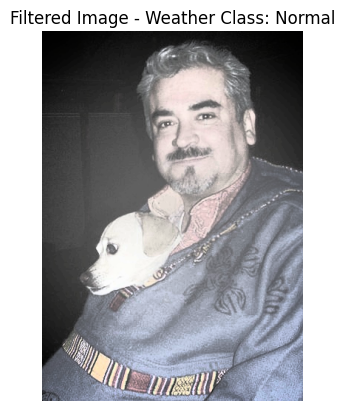

Processing /content/drive/MyDrive/test/000025_0.07.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000025_0.07.jpg: Normal


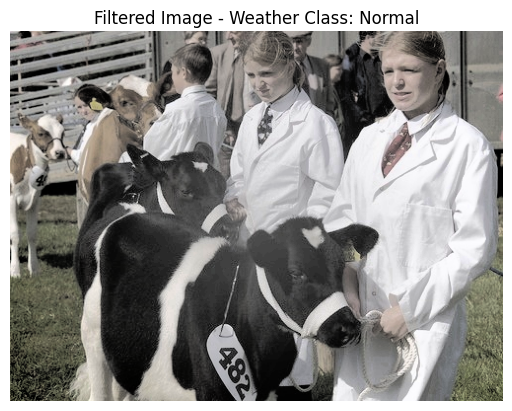

Processing /content/drive/MyDrive/test/000029_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000029_0.11.jpg: Foggy


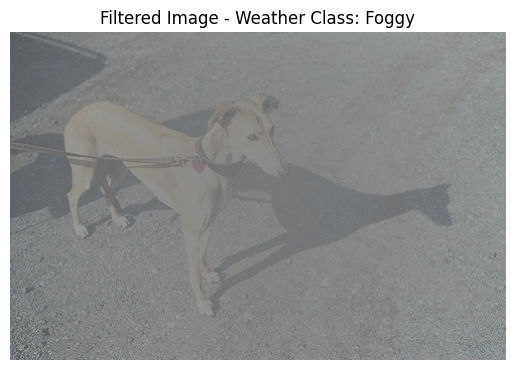

Processing /content/drive/MyDrive/test/000045_0.09.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000045_0.09.jpg: Normal


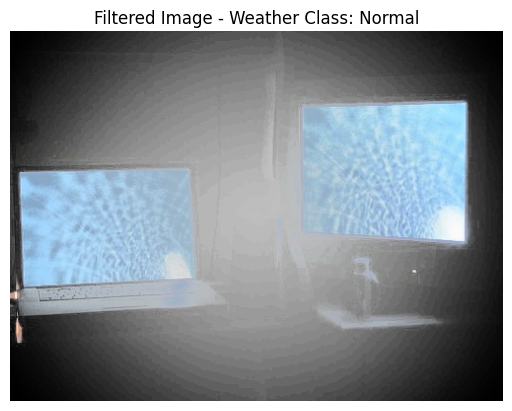

Processing /content/drive/MyDrive/test/000028_0.09.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000028_0.09.jpg: Normal


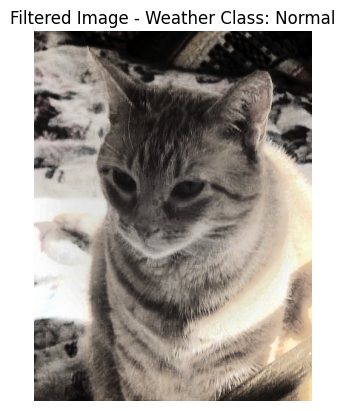

Processing /content/drive/MyDrive/test/000003_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000003_0.11.jpg: Normal


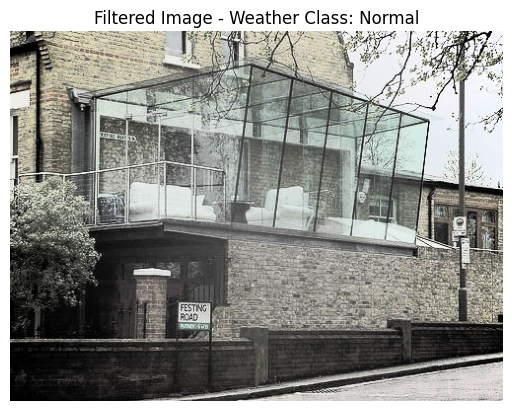

Processing /content/drive/MyDrive/test/000010_0.05.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000010_0.05.jpg: Foggy


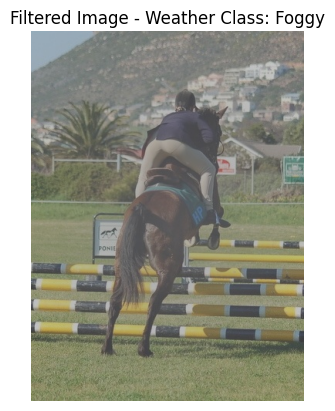

Processing /content/drive/MyDrive/test/000040_0.05.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000040_0.05.jpg: Normal


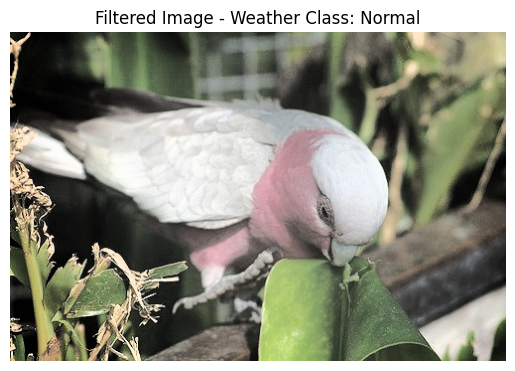

Processing /content/drive/MyDrive/test/000038_0.08.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000038_0.08.jpg: Foggy


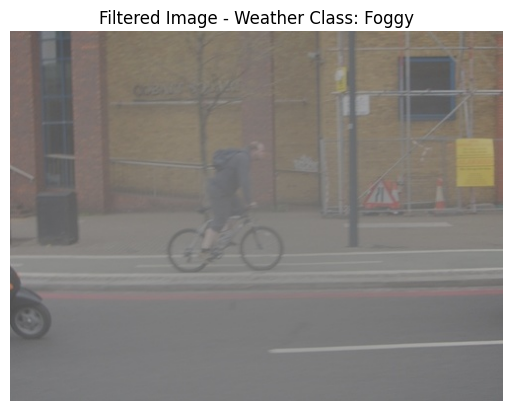

Processing /content/drive/MyDrive/test/000049_0.12.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000049_0.12.jpg: Foggy


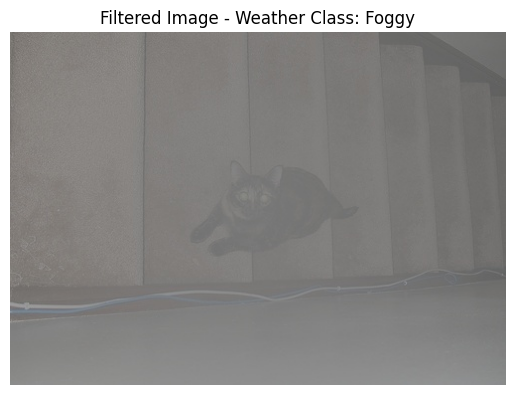

Processing /content/drive/MyDrive/test/000055_0.08.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000055_0.08.jpg: Normal


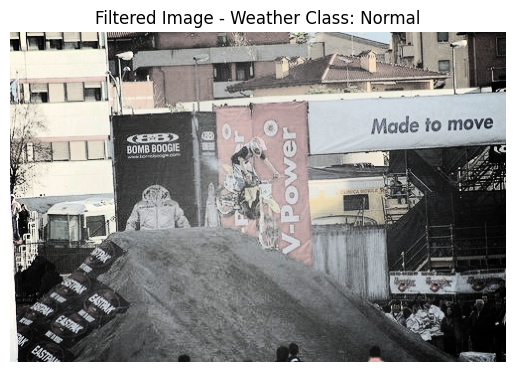

Processing /content/drive/MyDrive/test/000058_0.12.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000058_0.12.jpg: Normal


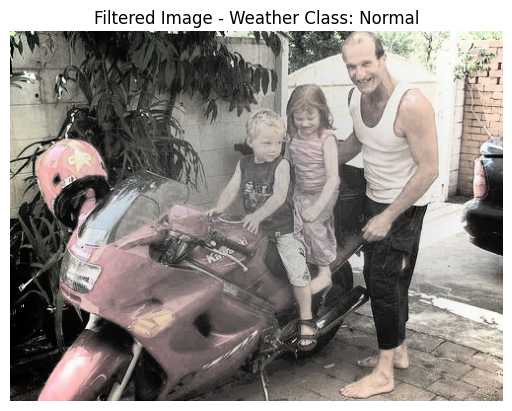

Processing /content/drive/MyDrive/test/000037_0.13.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000037_0.13.jpg: Foggy


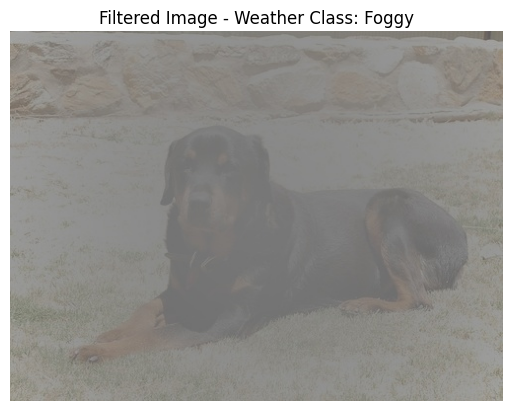

Processing /content/drive/MyDrive/test/000011_0.10.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000011_0.10.jpg: Foggy


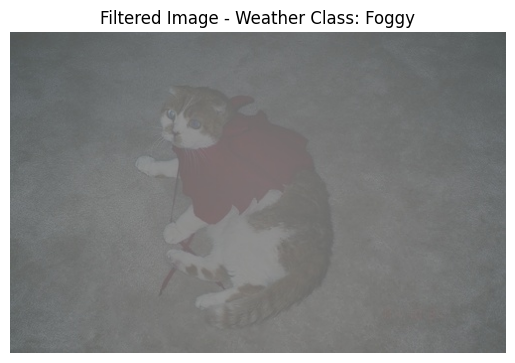

Processing /content/drive/MyDrive/test/000031_0.14.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000031_0.14.jpg: Foggy


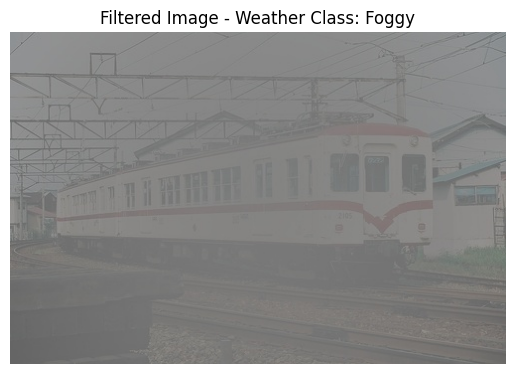

Processing /content/drive/MyDrive/test/000004_0.12.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000004_0.12.jpg: Foggy


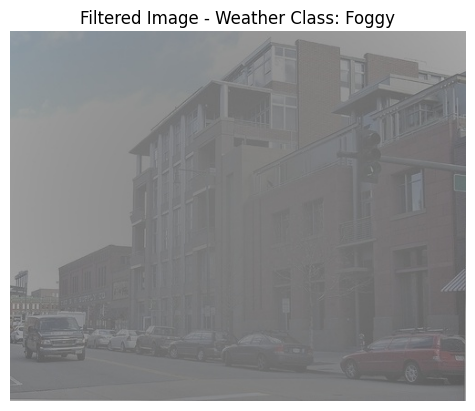

Processing /content/drive/MyDrive/test/000018_0.09.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000018_0.09.jpg: Foggy


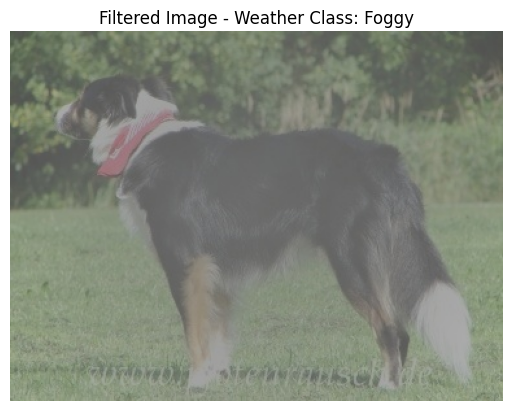

Processing /content/drive/MyDrive/test/000013_0.05.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000013_0.05.jpg: Foggy


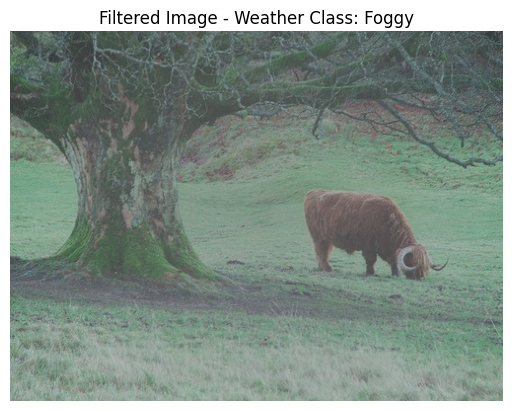

Processing /content/drive/MyDrive/test/000014_0.10.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000014_0.10.jpg: Normal


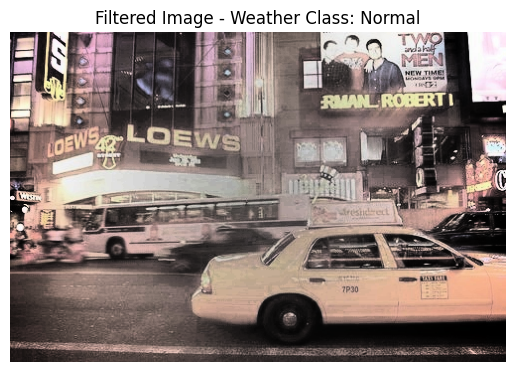

Processing /content/drive/MyDrive/test/000022_0.07.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000022_0.07.jpg: Normal


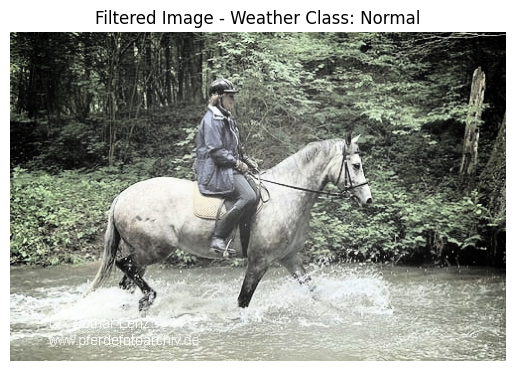

Processing /content/drive/MyDrive/test/000006_0.13.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000006_0.13.jpg: Foggy


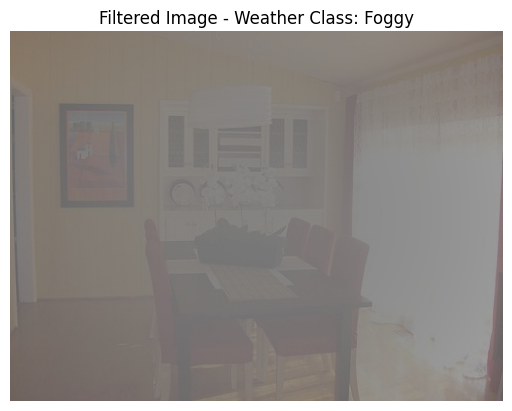

Processing /content/drive/MyDrive/test/000054_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000054_0.11.jpg: Normal


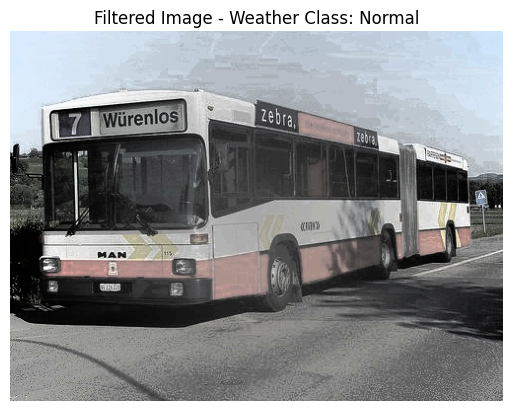

Processing /content/drive/MyDrive/test/000043_0.06.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000043_0.06.jpg: Normal


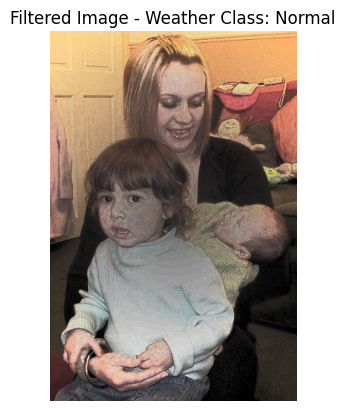

Processing /content/drive/MyDrive/test/000015_0.07.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000015_0.07.jpg: Normal


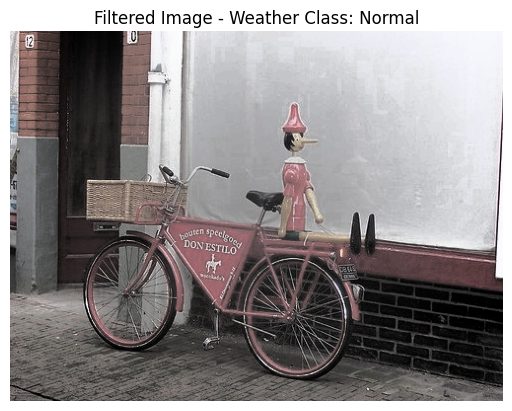

Processing /content/drive/MyDrive/test/000053_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000053_0.11.jpg: Normal


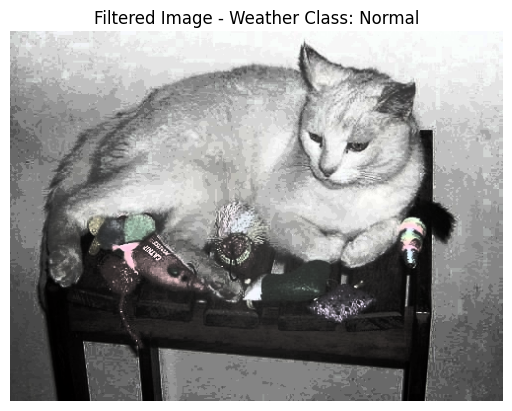

Processing /content/drive/MyDrive/test/000008_0.14.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000008_0.14.jpg: Foggy


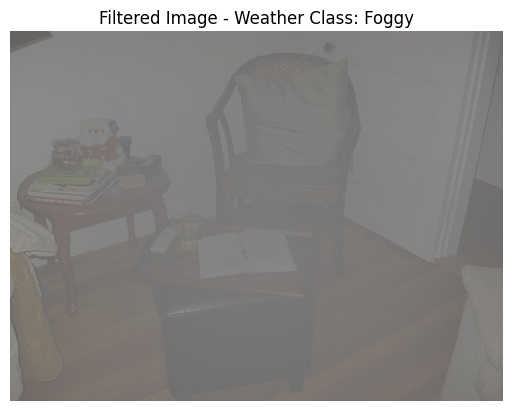

Processing /content/drive/MyDrive/test/000027_0.05.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000027_0.05.jpg: Normal


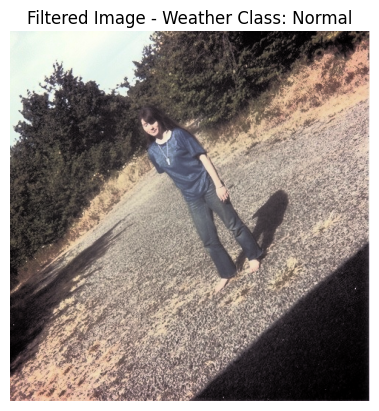

Processing /content/drive/MyDrive/test/000057_0.06.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000057_0.06.jpg: Foggy


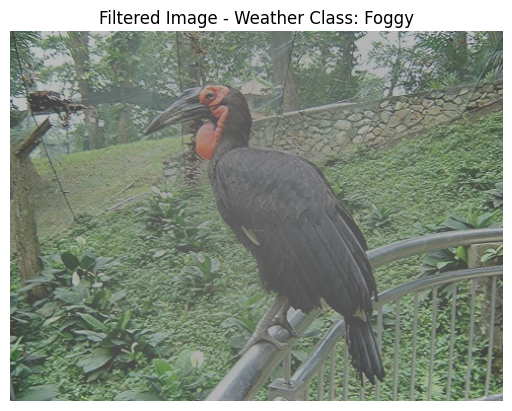

Processing /content/drive/MyDrive/test/000056_0.13.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000056_0.13.jpg: Normal


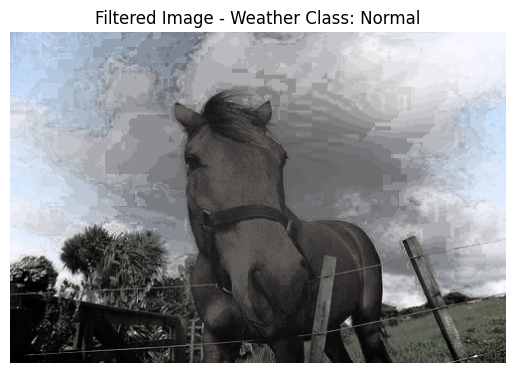

Processing /content/drive/MyDrive/test/000002_0.11.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/000002_0.11.jpg: Normal


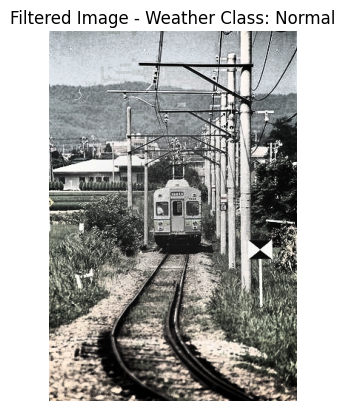

Processing /content/drive/MyDrive/test/Copy of 2012_004319.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/Copy of 2012_004319.jpg: Rainy


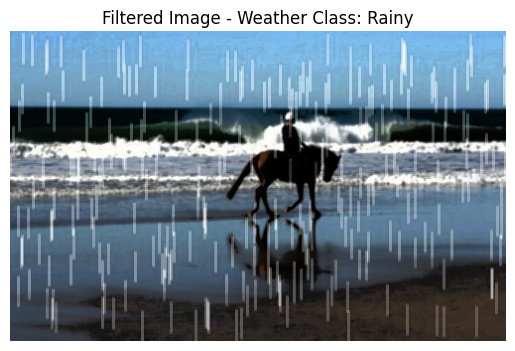

Processing /content/drive/MyDrive/test/Copy of 2012_004329.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/Copy of 2012_004329.jpg: Rainy


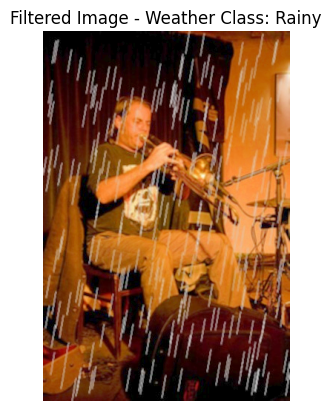

Processing /content/drive/MyDrive/test/2012_004317.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/2012_004317.jpg: Rainy


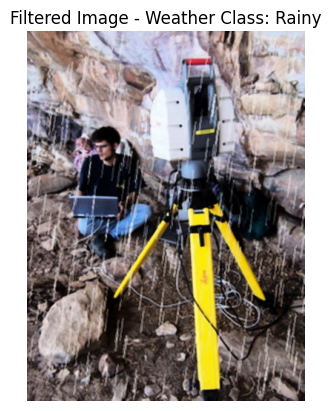

Processing /content/drive/MyDrive/test/Copy of 2012_004330.jpg...
Predicted Weather Class for /content/drive/MyDrive/test/Copy of 2012_004330.jpg: Rainy


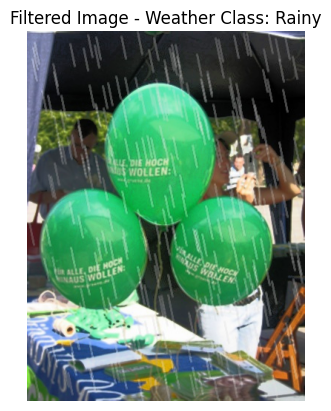

In [ ]:
#Here we are trying to print the output of the Weather classifier and the filter
import os
import torch
from PIL import Image
import torchvision.transforms as transforms
import yaml
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

weather_model = WeatherCNN(num_classes=len(class_names)).to(device)
weather_model.load_state_dict(torch.load('/content/drive/MyDrive/AI-P-checkpoint/cnn_weather_classifier.pth'))
weather_model.eval()
'''
yolo_model = YOLO('/content/drive/MyDrive/AI-P-checkpoint/yolov8_weather_model.pt')

with open('/content/drive/MyDrive/Data/images/dataset.yaml') as file:
    data = yaml.safe_load(file)
    class_names_yolo = data['names']
'''
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def process_image(image_path):
    # Load and display the original image
    original_image = Image.open(image_path).convert('RGB')
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('off')  # Hide axes
    plt.show()

    input_image = transform(original_image).unsqueeze(0).to(device)  # Here we preprocess and classify the weather condition of the image
    with torch.no_grad():
        weather_output = weather_model(input_image)
        weather_class = torch.argmax(weather_output, dim=1).item()
        weather_class_name = class_names[weather_class]
    image_np = np.array(original_image)
    filtered_image = apply_dip(image_np, weather_class)
    filtered_image_bgr = cv2.cvtColor(filtered_image, cv2.COLOR_RGB2BGR)

    # Display the filtered image
    plt.imshow(cv2.cvtColor(filtered_image_bgr, cv2.COLOR_BGR2RGB))
    plt.title(f'Filtered Image')
    plt.axis('off')  # Hide axes
    plt.show()

    '''
    yolo_results = yolo_model.predict(filtered_image_bgr, conf=0.25)

    for result in yolo_results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            confidence = box.conf[0]
            class_id = int(box.cls[0])
            class_name_yolo = class_names_yolo[class_id] if class_id < len(class_names_yolo) else "Unknown"
            label = f'{class_name_yolo}: {confidence:.2f}'
            cv2.rectangle(filtered_image_bgr, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(filtered_image_bgr, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Display the annotated image
    plt.imshow(cv2.cvtColor(filtered_image_bgr, cv2.COLOR_BGR2RGB))
    plt.title('Annotated Image with Detections')
    plt.axis('off')
    plt.show()
'''
test_folder_path = '/content/drive/MyDrive/test'

for image_name in os.listdir(test_folder_path):
    image_path = os.path.join(test_folder_path, image_name)
    if image_name.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
        print(f'Processing {image_path}...')
        process_image(image_path)

Processing /content/drive/MyDrive/test/000001_0.11.jpg...


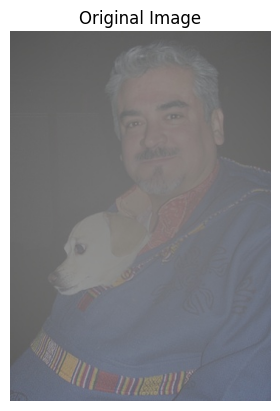

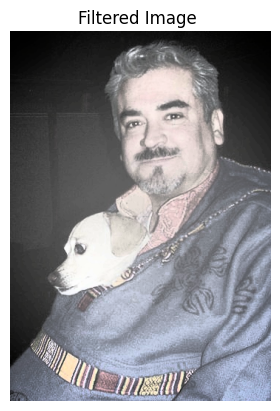


0: 640x480 1 dog, 1 person, 28.5ms
Speed: 2.6ms preprocess, 28.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)


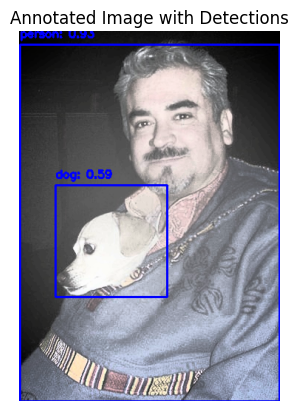

Processing /content/drive/MyDrive/test/000025_0.07.jpg...


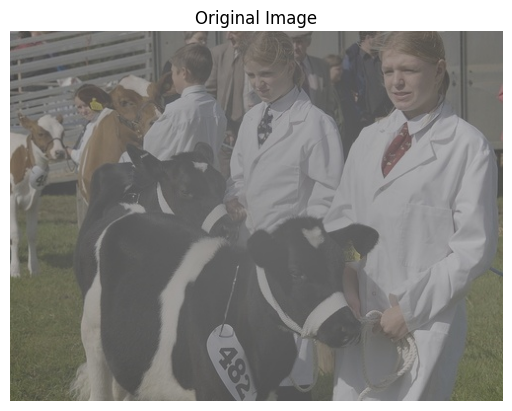

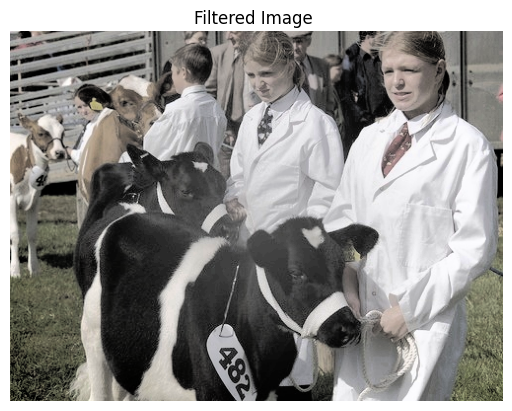


0: 480x640 4 cows, 2 persons, 28.9ms
Speed: 2.8ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


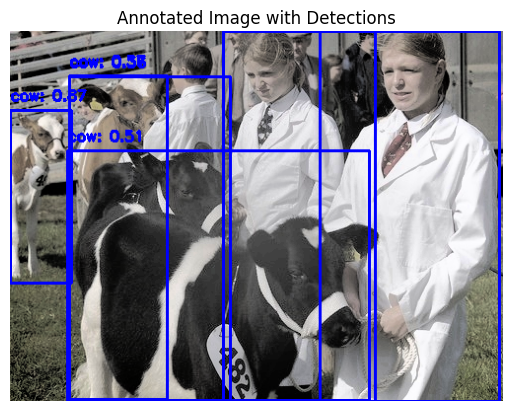

Processing /content/drive/MyDrive/test/000029_0.11.jpg...


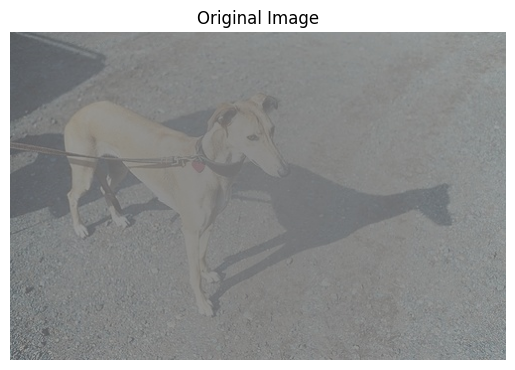

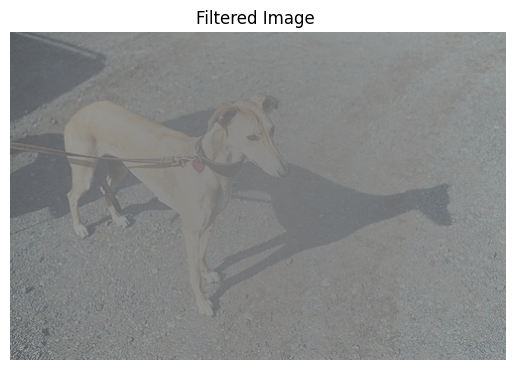


0: 448x640 1 dog, 28.1ms
Speed: 2.3ms preprocess, 28.1ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


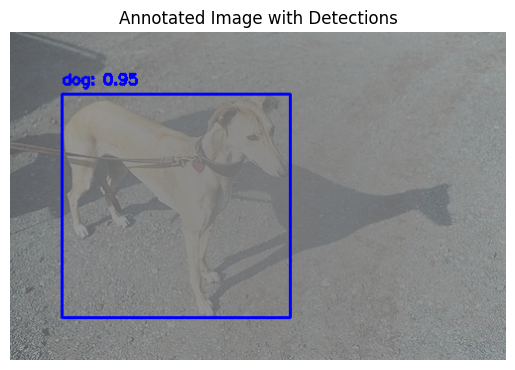

Processing /content/drive/MyDrive/test/000045_0.09.jpg...


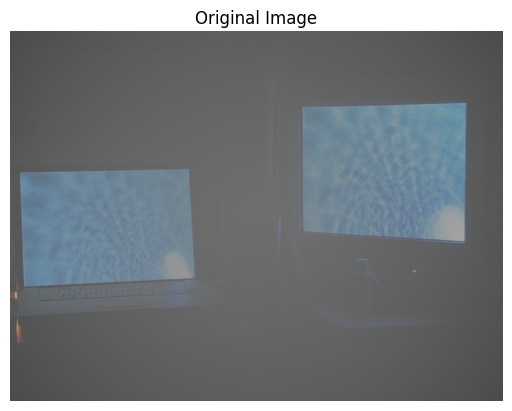

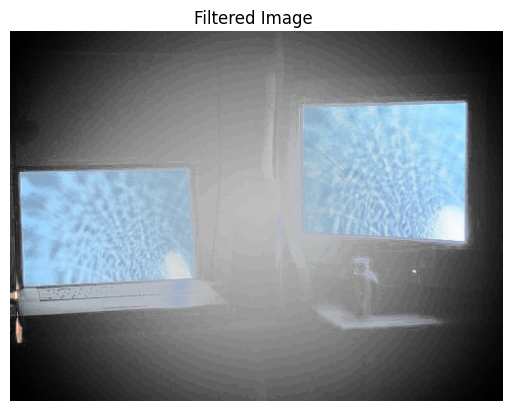


0: 480x640 1 tvmonitor, 28.9ms
Speed: 2.5ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


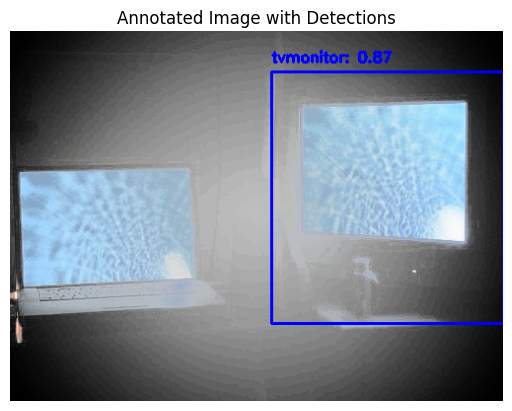

Processing /content/drive/MyDrive/test/000028_0.09.jpg...


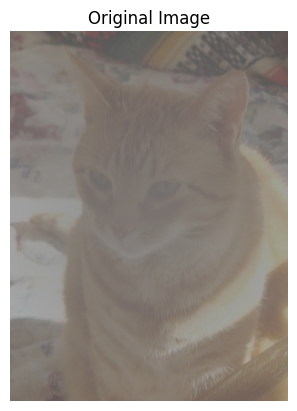

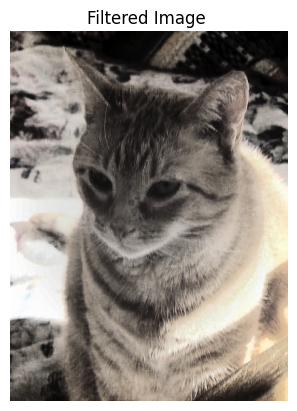


0: 640x480 1 cat, 30.3ms
Speed: 2.9ms preprocess, 30.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


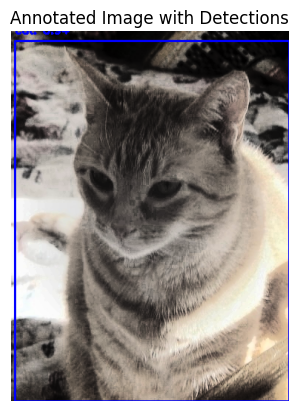

Processing /content/drive/MyDrive/test/000003_0.11.jpg...


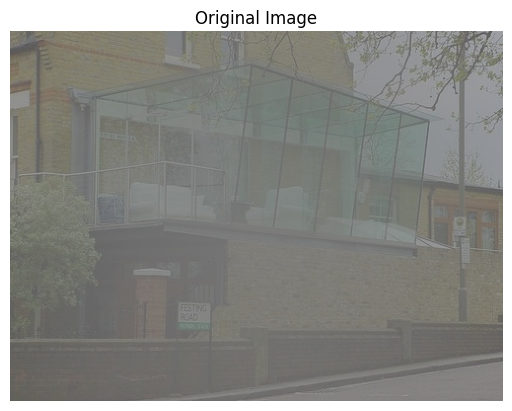

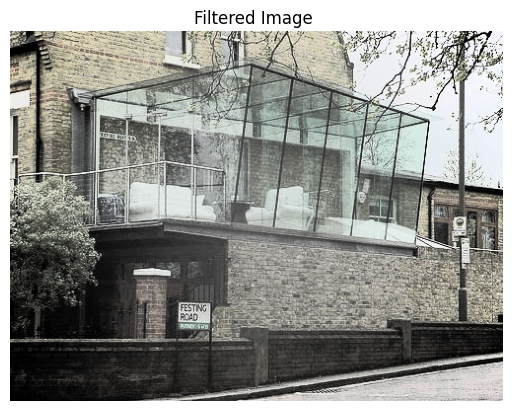


0: 480x640 1 pottedplant, 28.9ms
Speed: 2.5ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


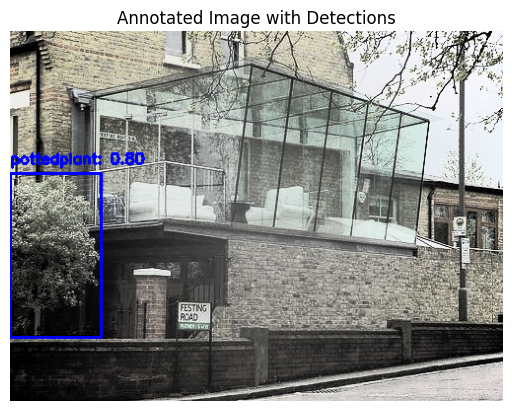

Processing /content/drive/MyDrive/test/000010_0.05.jpg...


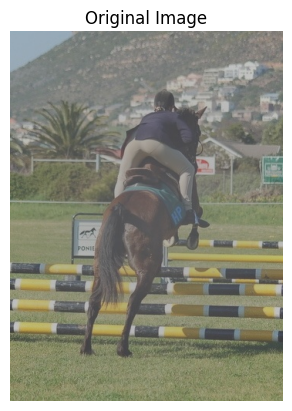

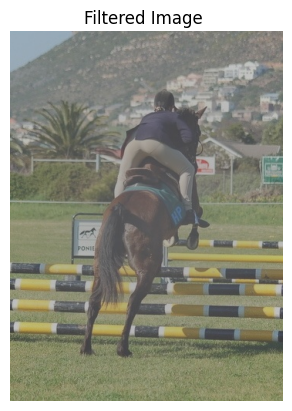


0: 640x480 1 person, 28.5ms
Speed: 2.2ms preprocess, 28.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


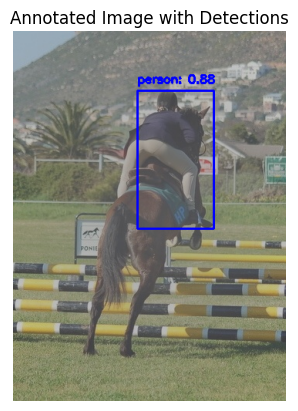

Processing /content/drive/MyDrive/test/000040_0.05.jpg...


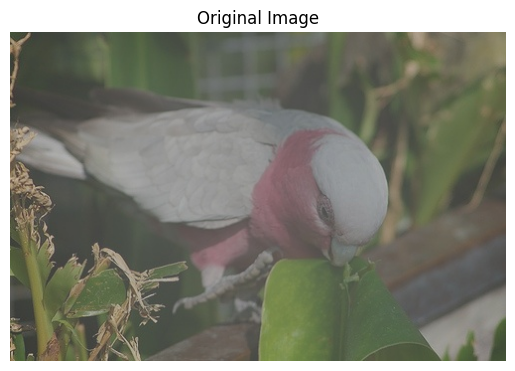

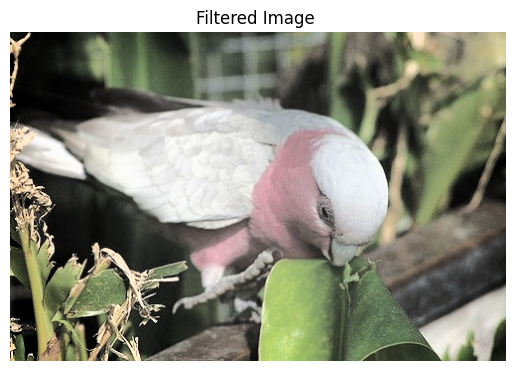


0: 448x640 2 birds, 28.2ms
Speed: 2.3ms preprocess, 28.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


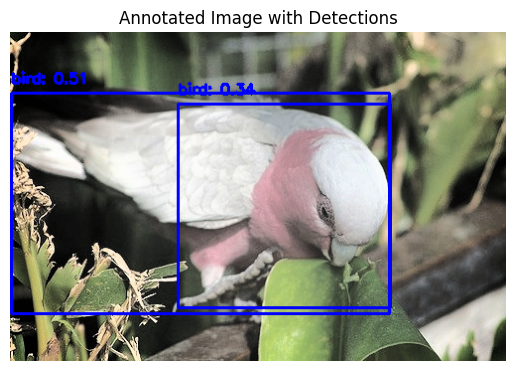

Processing /content/drive/MyDrive/test/000038_0.08.jpg...


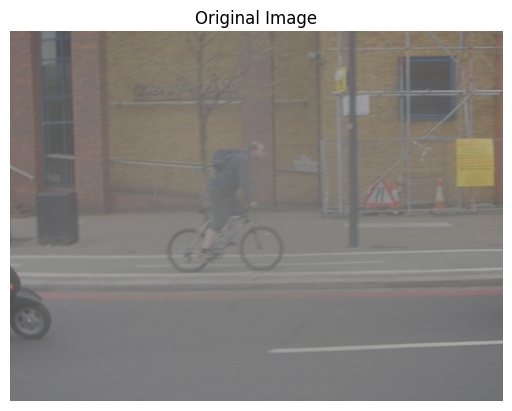

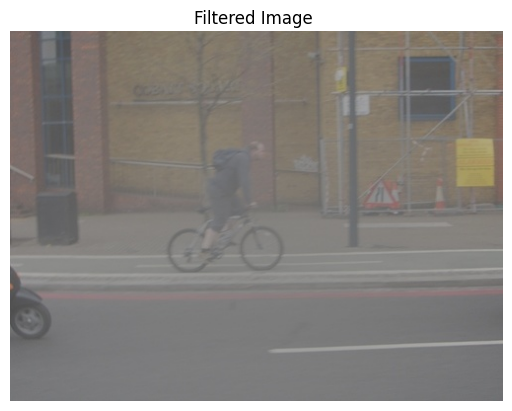


0: 480x640 1 bicycle, 1 person, 28.9ms
Speed: 2.9ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


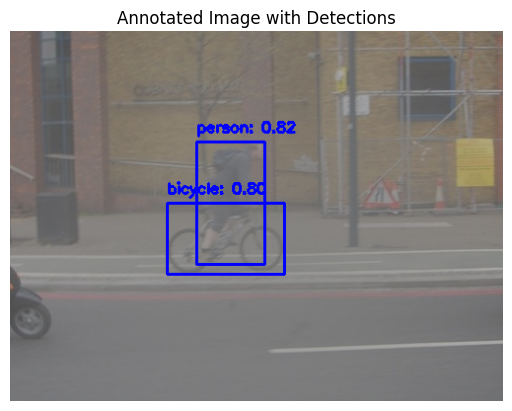

Processing /content/drive/MyDrive/test/000049_0.12.jpg...


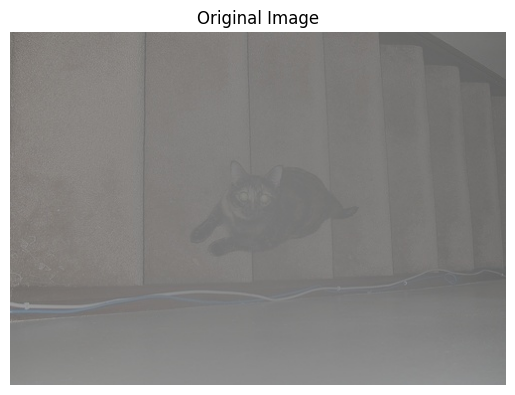

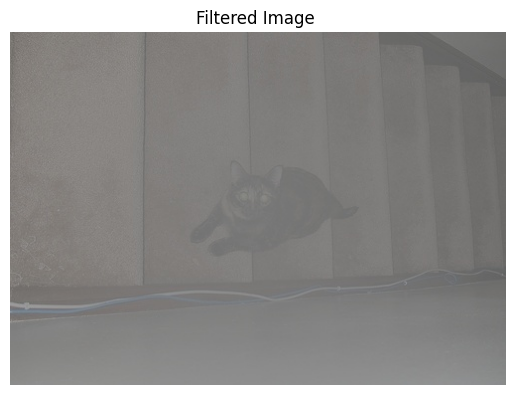


0: 480x640 1 cat, 28.0ms
Speed: 2.0ms preprocess, 28.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


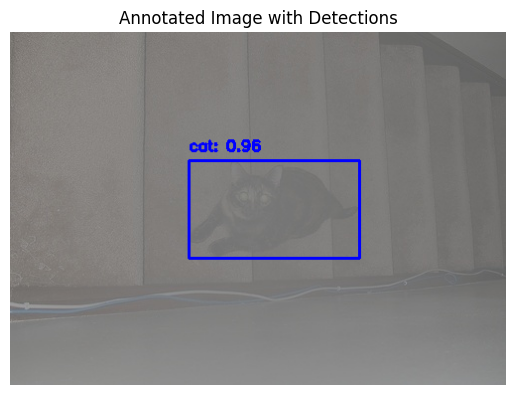

Processing /content/drive/MyDrive/test/000055_0.08.jpg...


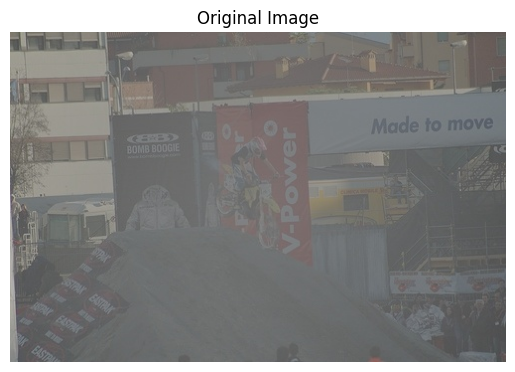

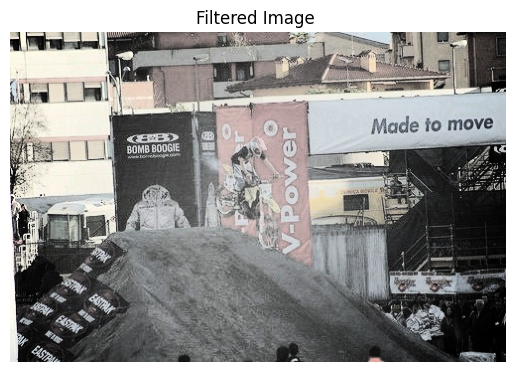


0: 448x640 2 persons, 28.5ms
Speed: 2.5ms preprocess, 28.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


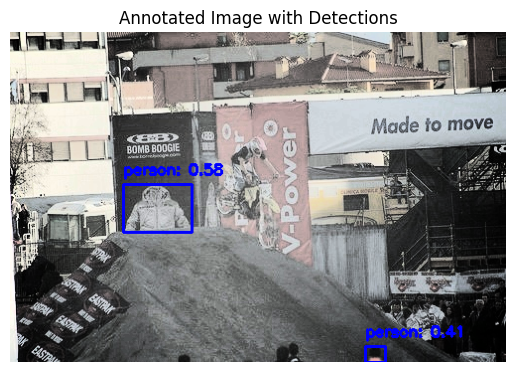

Processing /content/drive/MyDrive/test/000058_0.12.jpg...


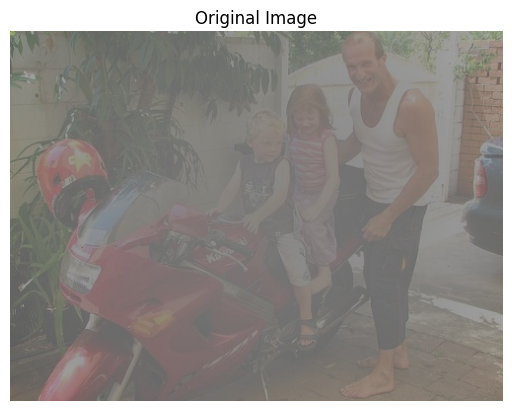

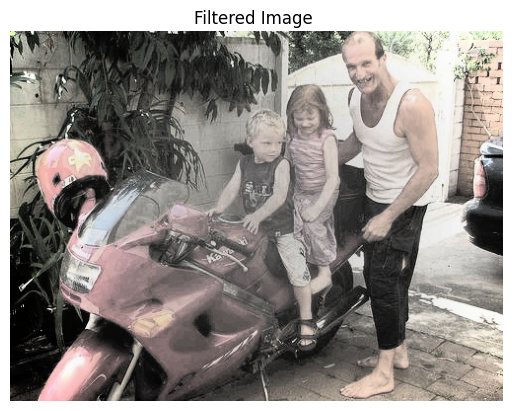


0: 480x640 1 car, 1 motorbike, 4 persons, 29.0ms
Speed: 2.1ms preprocess, 29.0ms inference, 2.7ms postprocess per image at shape (1, 3, 480, 640)


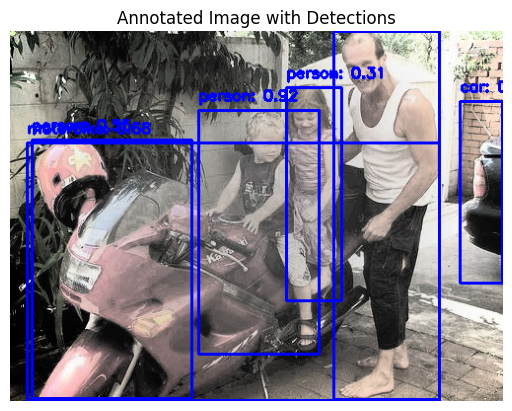

Processing /content/drive/MyDrive/test/000037_0.13.jpg...


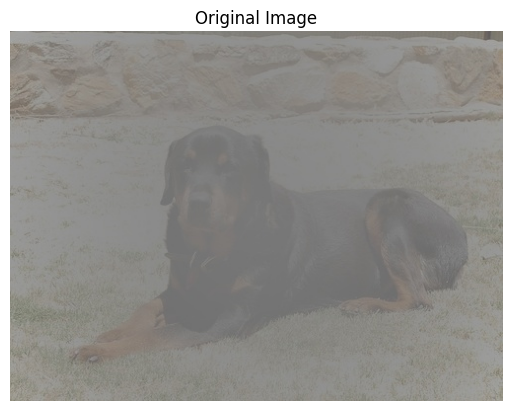

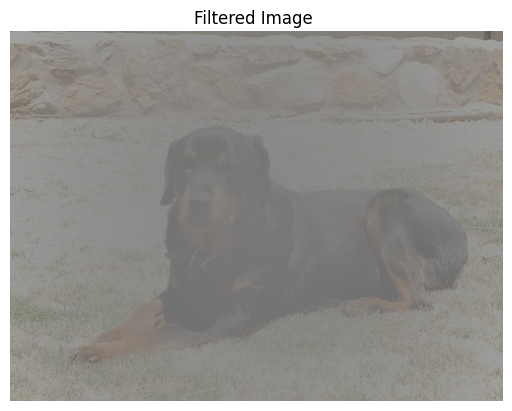


0: 480x640 1 dog, 28.1ms
Speed: 2.5ms preprocess, 28.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


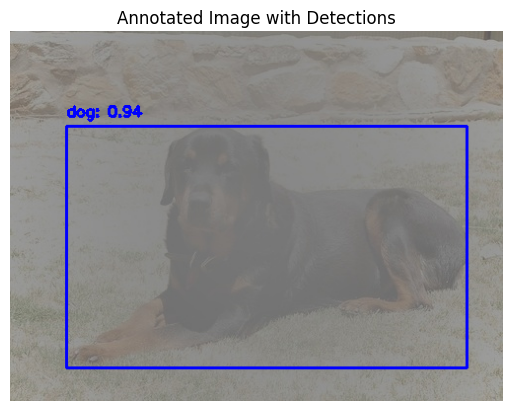

Processing /content/drive/MyDrive/test/000011_0.10.jpg...


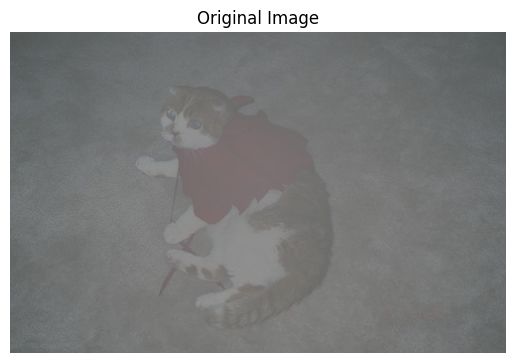

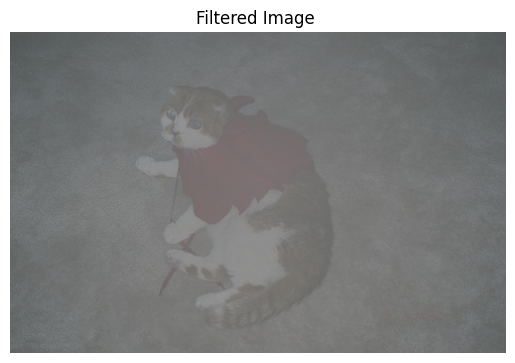


0: 416x640 1 bird, 1 cat, 27.8ms
Speed: 2.9ms preprocess, 27.8ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


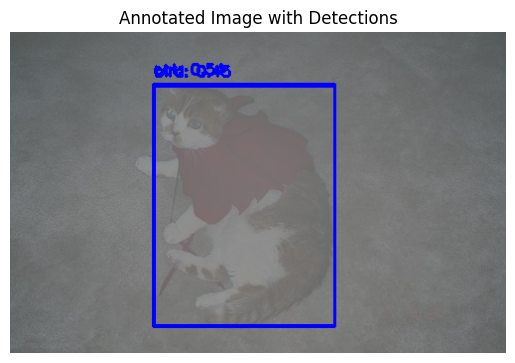

Processing /content/drive/MyDrive/test/000031_0.14.jpg...


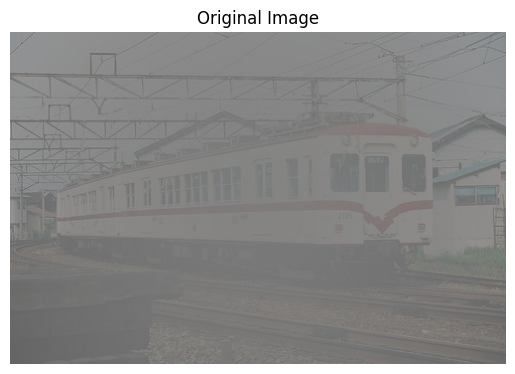

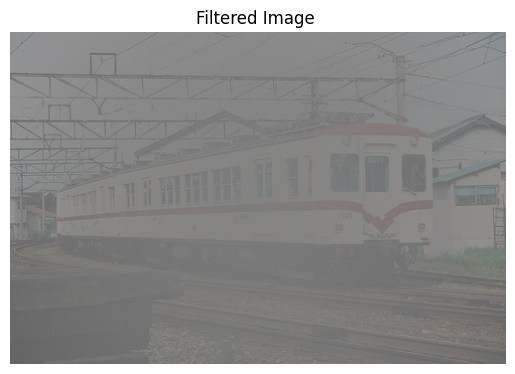


0: 448x640 1 train, 28.6ms
Speed: 2.1ms preprocess, 28.6ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


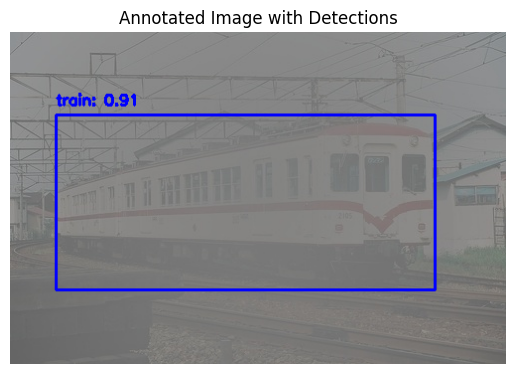

Processing /content/drive/MyDrive/test/000004_0.12.jpg...


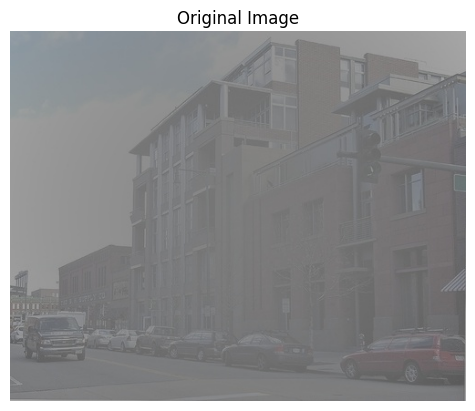

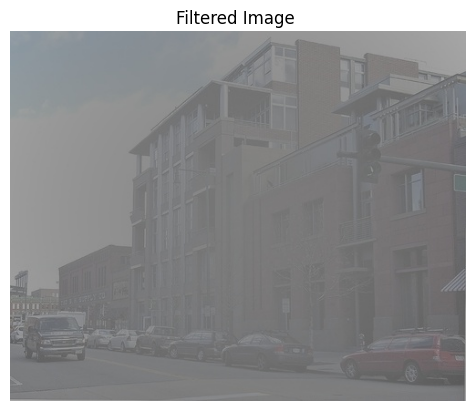


0: 544x640 8 cars, 36.4ms
Speed: 2.4ms preprocess, 36.4ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)


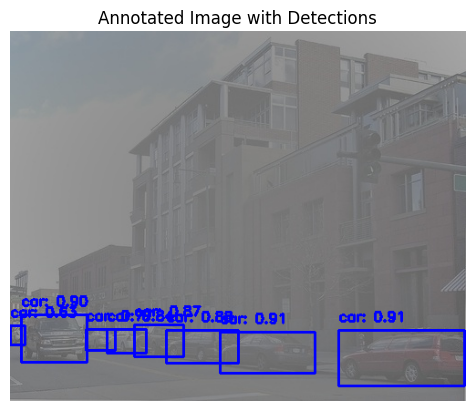

Processing /content/drive/MyDrive/test/000018_0.09.jpg...


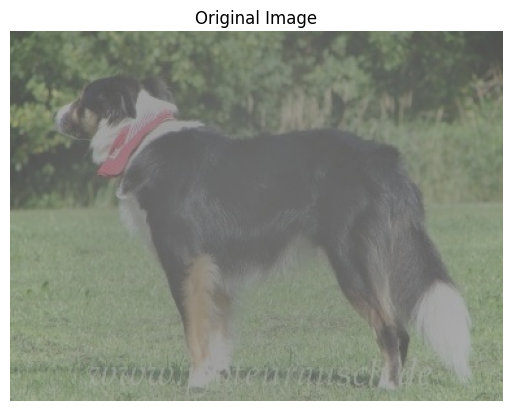

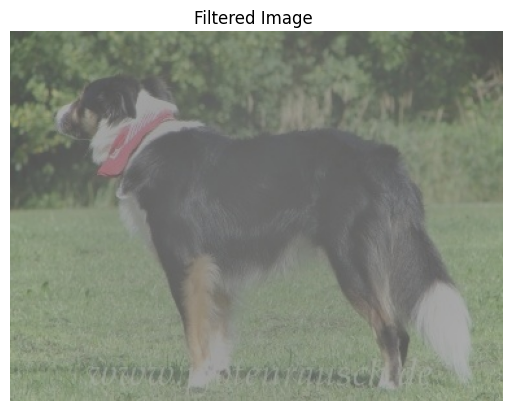


0: 480x640 1 dog, 28.9ms
Speed: 2.0ms preprocess, 28.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


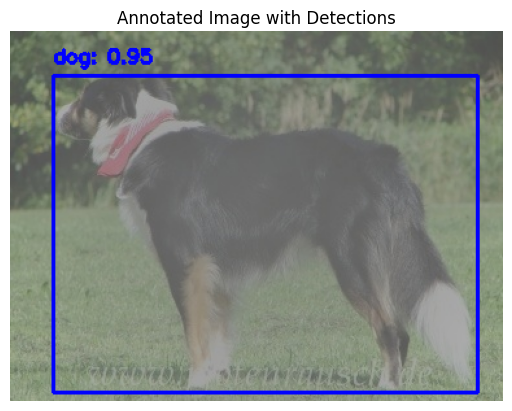

Processing /content/drive/MyDrive/test/000013_0.05.jpg...


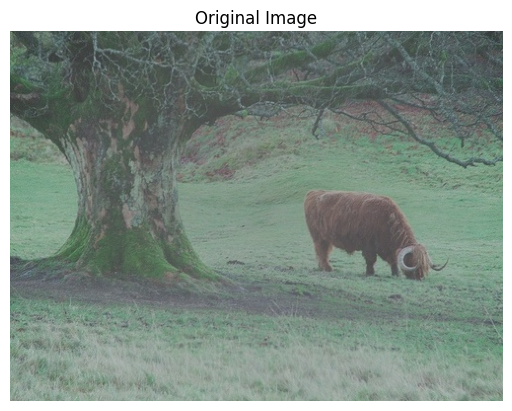

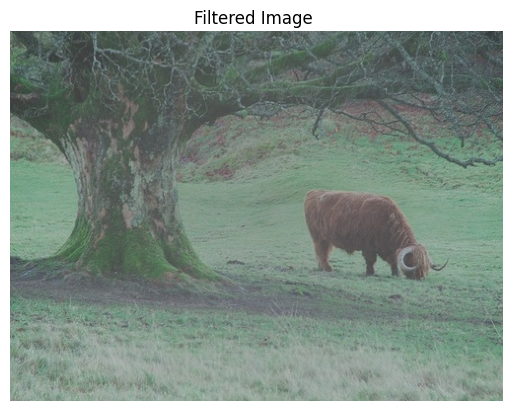


0: 480x640 1 cow, 28.0ms
Speed: 2.2ms preprocess, 28.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


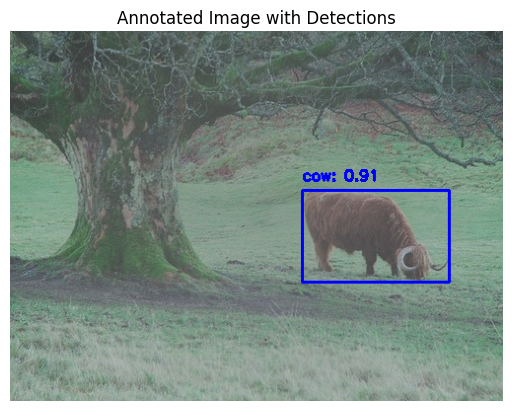

Processing /content/drive/MyDrive/test/000014_0.10.jpg...


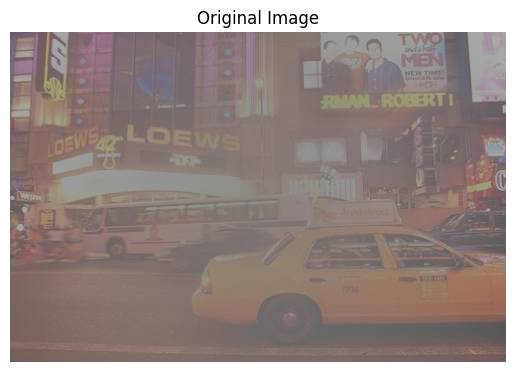

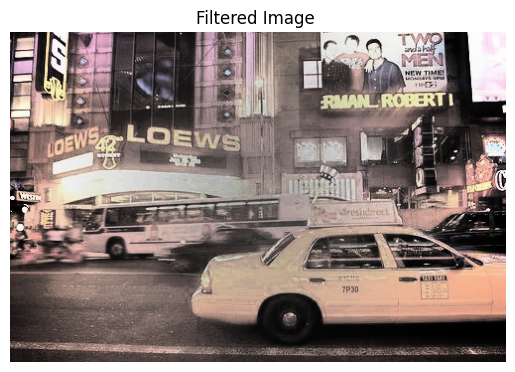


0: 448x640 1 bus, 2 cars, 1 person, 1 tvmonitor, 31.3ms
Speed: 2.5ms preprocess, 31.3ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


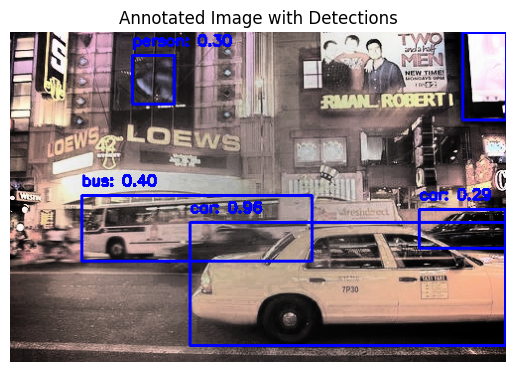

Processing /content/drive/MyDrive/test/000022_0.07.jpg...


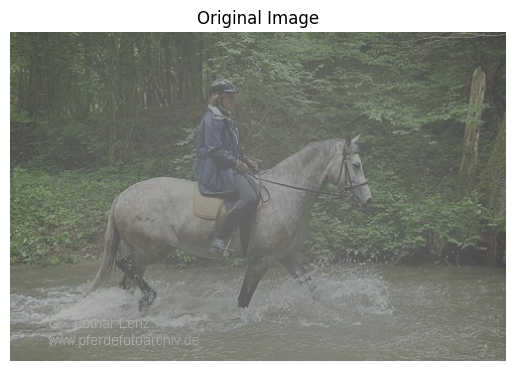

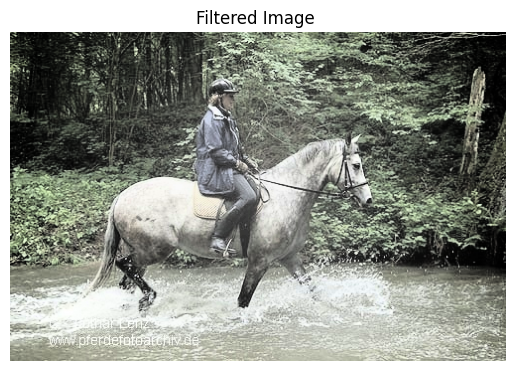


0: 448x640 1 horse, 1 person, 27.4ms
Speed: 2.2ms preprocess, 27.4ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


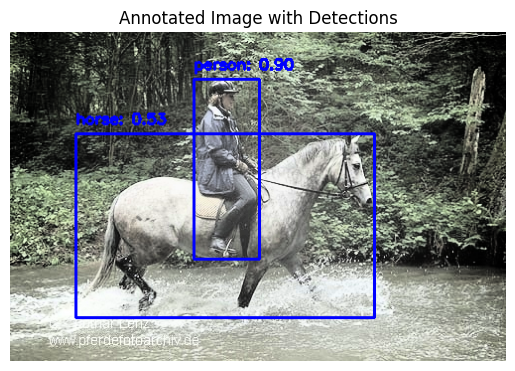

Processing /content/drive/MyDrive/test/000006_0.13.jpg...


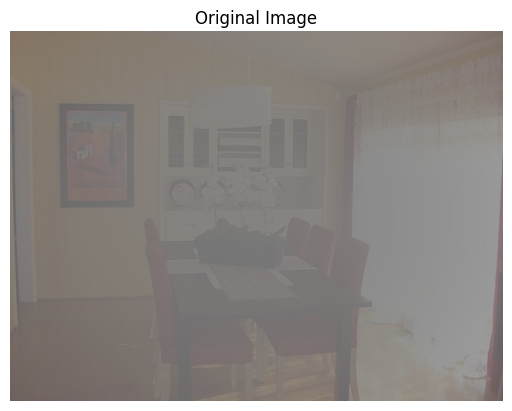

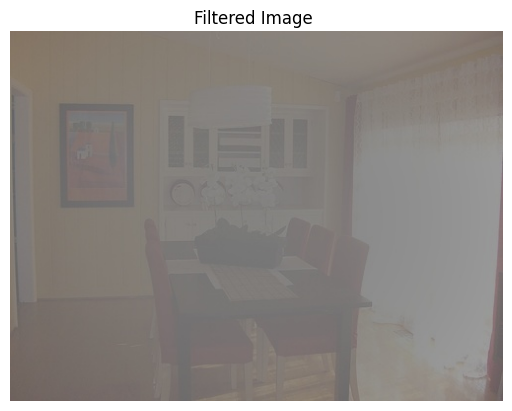


0: 480x640 4 chairs, 1 diningtable, 29.0ms
Speed: 2.2ms preprocess, 29.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


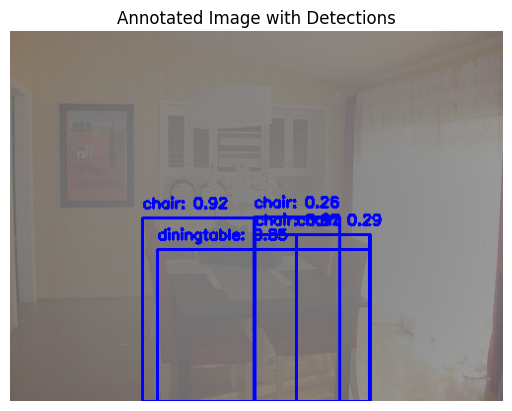

Processing /content/drive/MyDrive/test/000054_0.11.jpg...


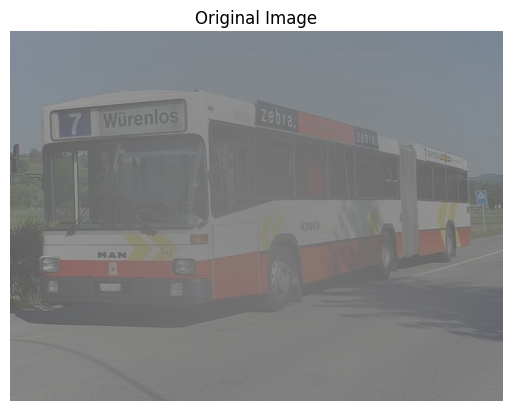

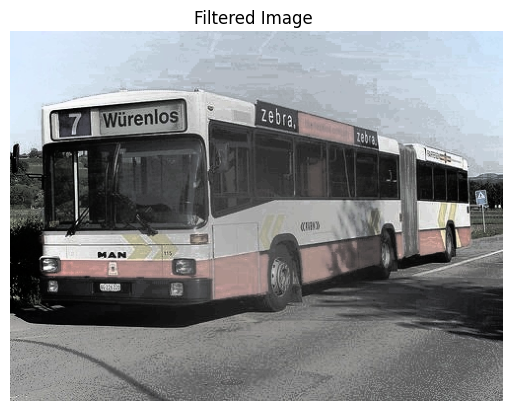


0: 480x640 1 bus, 28.1ms
Speed: 3.2ms preprocess, 28.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


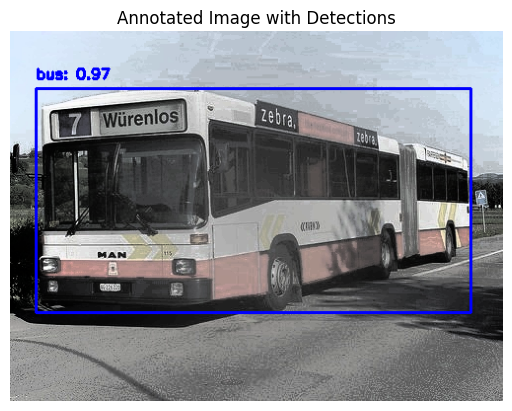

Processing /content/drive/MyDrive/test/000043_0.06.jpg...


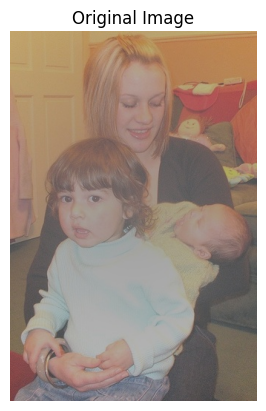

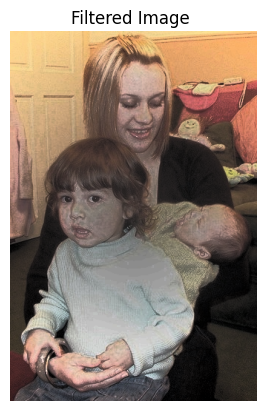


0: 640x448 2 persons, 28.4ms
Speed: 2.9ms preprocess, 28.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 448)


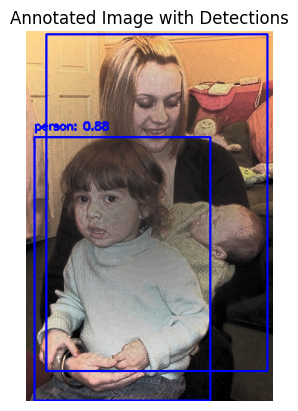

Processing /content/drive/MyDrive/test/000015_0.07.jpg...


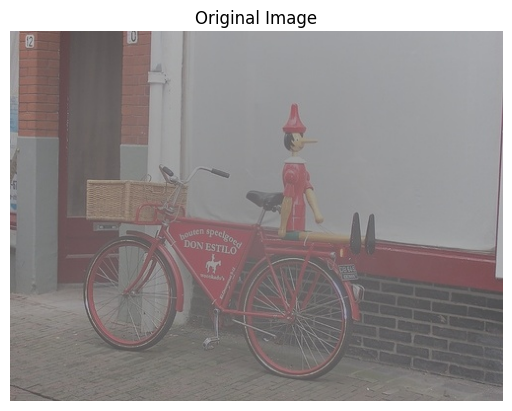

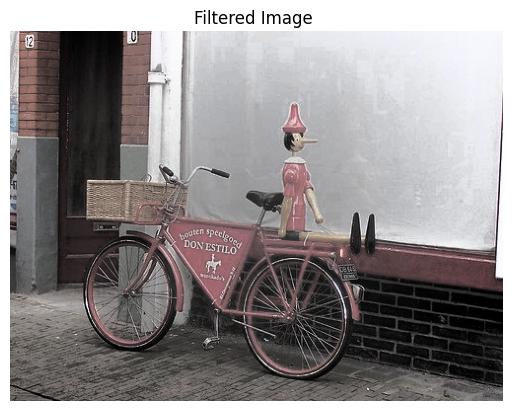


0: 480x640 1 bicycle, 29.5ms
Speed: 3.0ms preprocess, 29.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


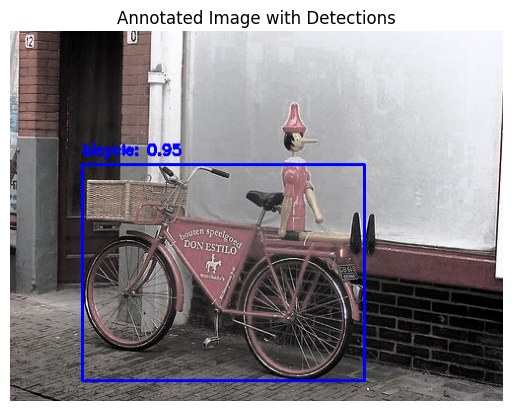

Processing /content/drive/MyDrive/test/000053_0.11.jpg...


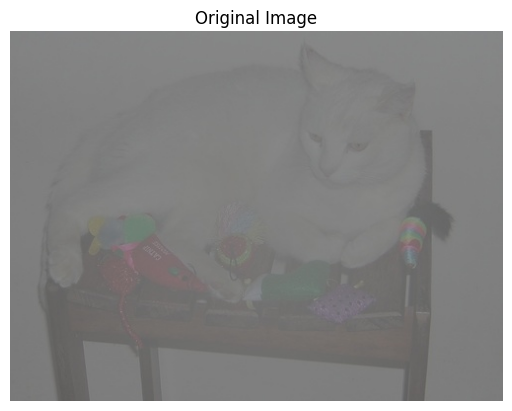

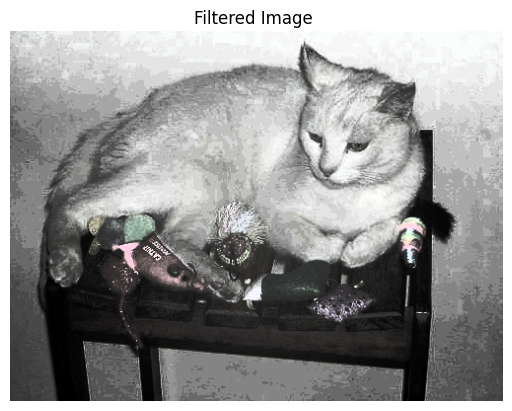


0: 480x640 1 cat, 1 chair, 28.1ms
Speed: 3.3ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


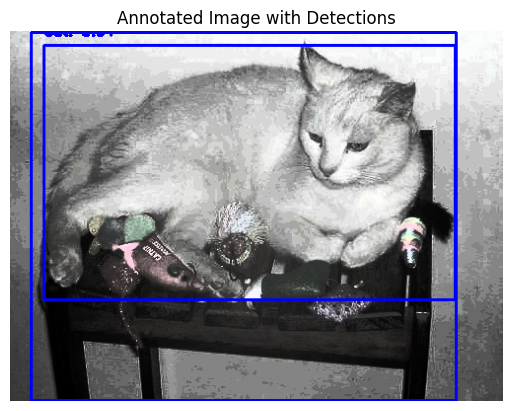

Processing /content/drive/MyDrive/test/000008_0.14.jpg...


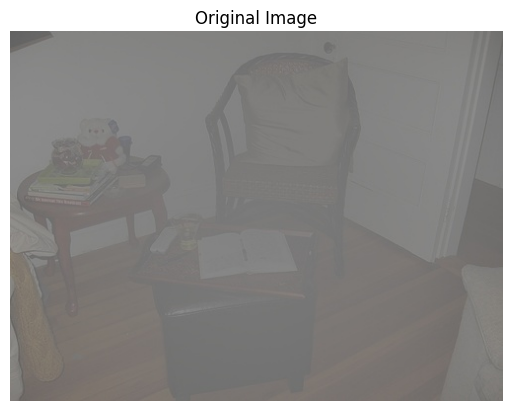

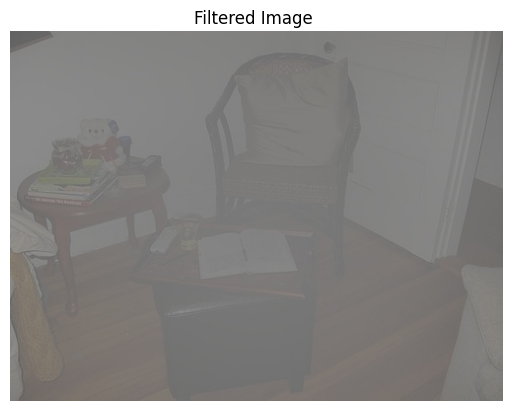


0: 480x640 1 chair, 28.0ms
Speed: 2.2ms preprocess, 28.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


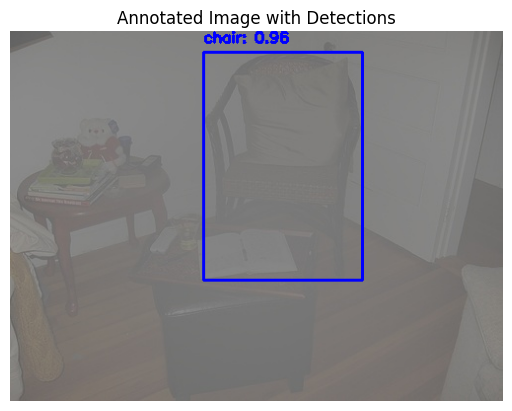

Processing /content/drive/MyDrive/test/000027_0.05.jpg...


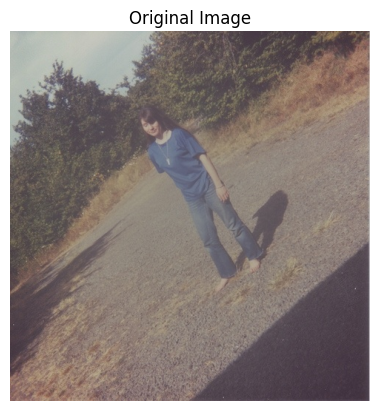

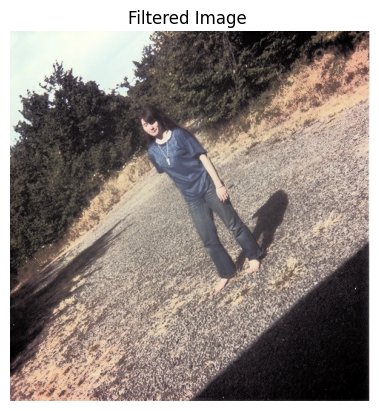


0: 640x640 1 person, 38.3ms
Speed: 2.9ms preprocess, 38.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


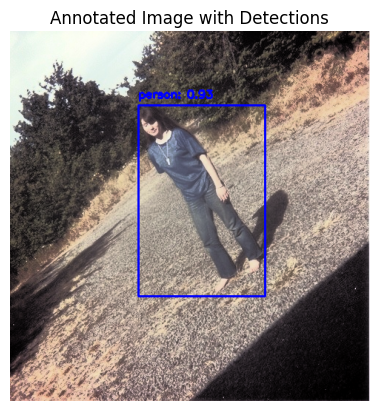

Processing /content/drive/MyDrive/test/000057_0.06.jpg...


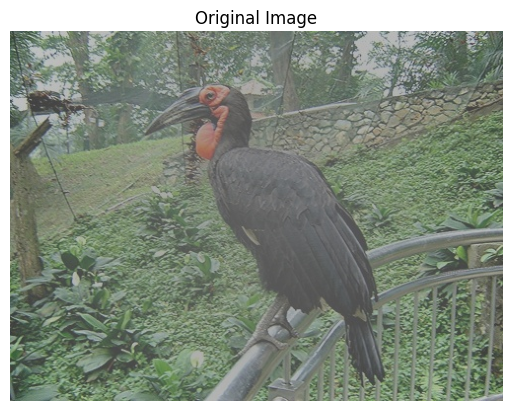

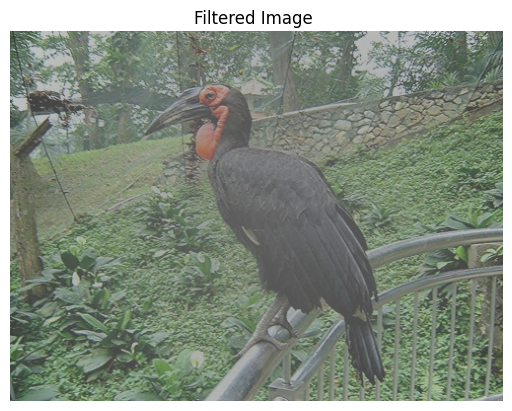


0: 480x640 1 bird, 28.9ms
Speed: 2.2ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


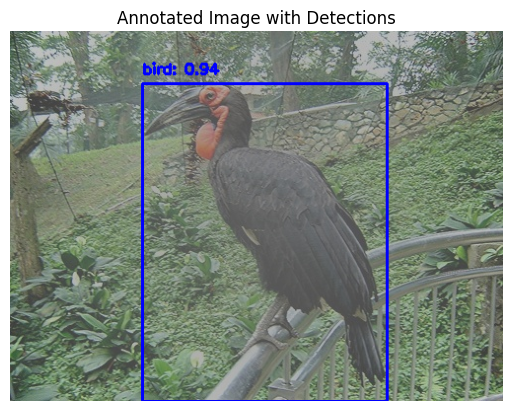

Processing /content/drive/MyDrive/test/000056_0.13.jpg...


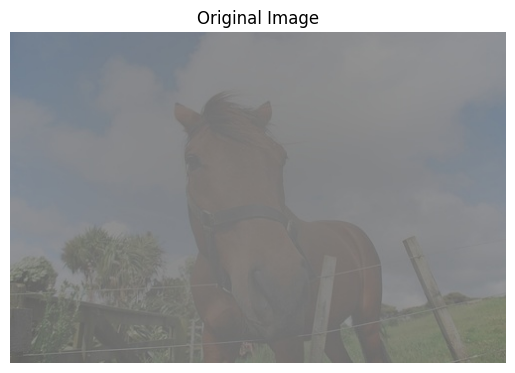

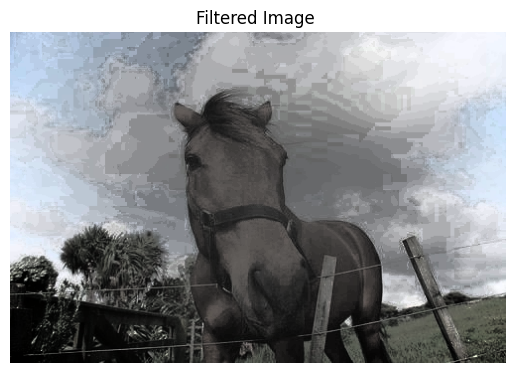


0: 448x640 1 horse, 28.1ms
Speed: 1.8ms preprocess, 28.1ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


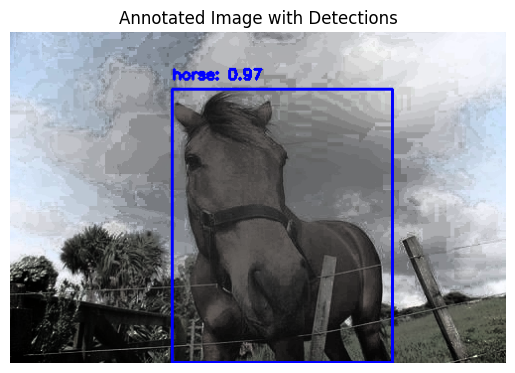

Processing /content/drive/MyDrive/test/000002_0.11.jpg...


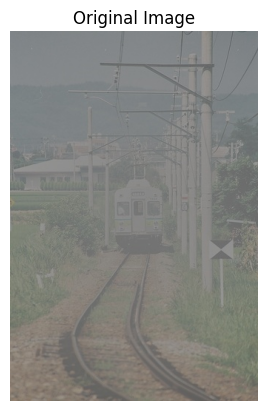

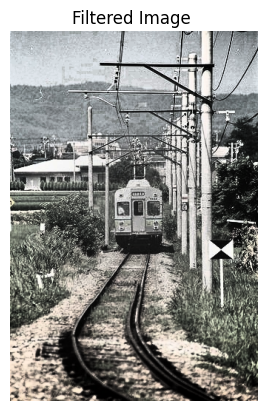


0: 640x448 1 train, 28.3ms
Speed: 2.9ms preprocess, 28.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 448)


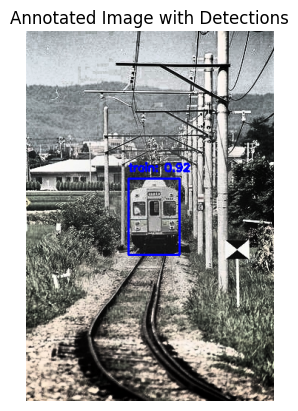

Processing /content/drive/MyDrive/test/2012_004317.jpg...


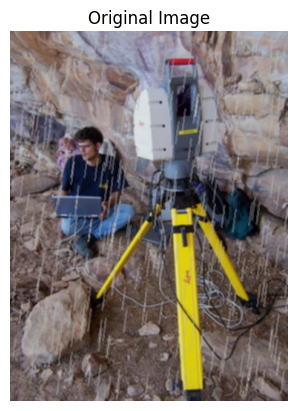

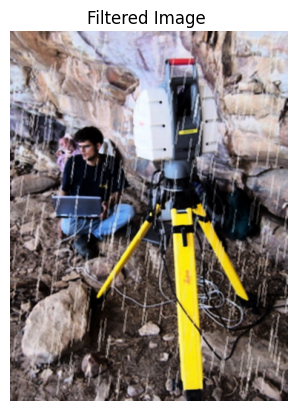


0: 640x480 1 person, 28.9ms
Speed: 3.3ms preprocess, 28.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


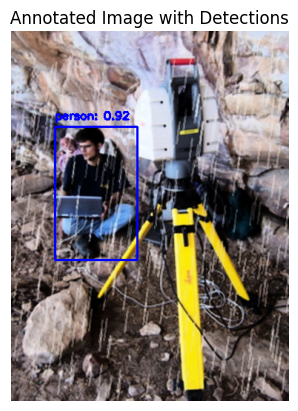

Processing /content/drive/MyDrive/test/2012_004319.jpg...


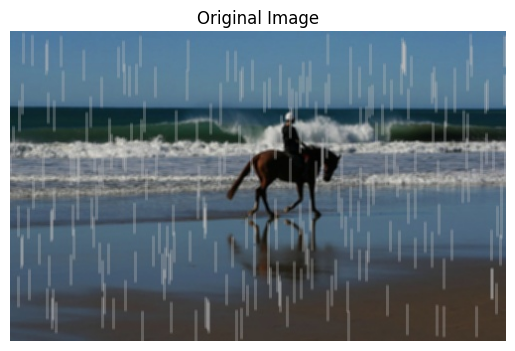

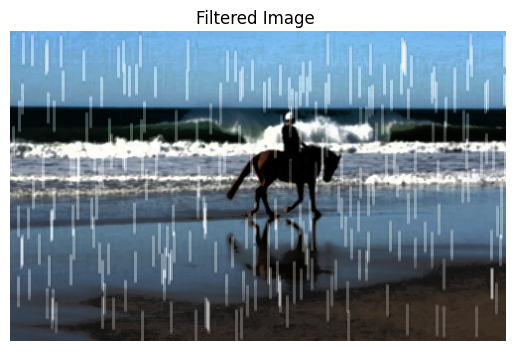


0: 416x640 1 horse, 1 person, 27.8ms
Speed: 2.1ms preprocess, 27.8ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


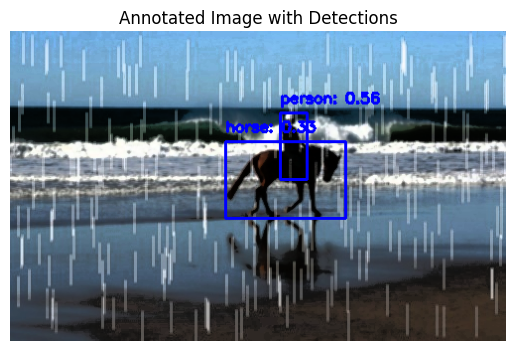

Processing /content/drive/MyDrive/test/2012_004329.jpg...


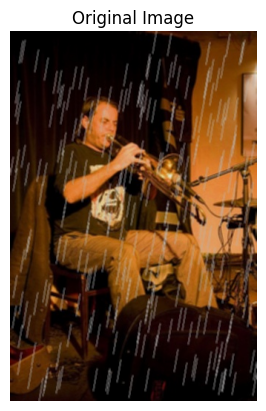

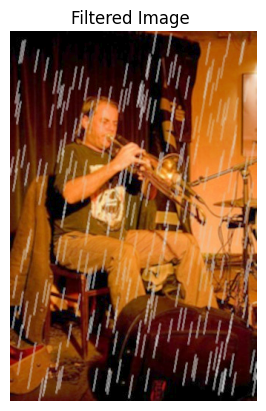


0: 640x448 1 person, 28.1ms
Speed: 2.7ms preprocess, 28.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 448)


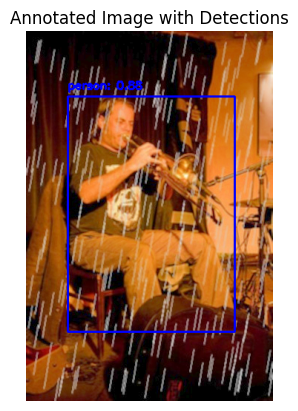

Processing /content/drive/MyDrive/test/2012_004330.jpg...


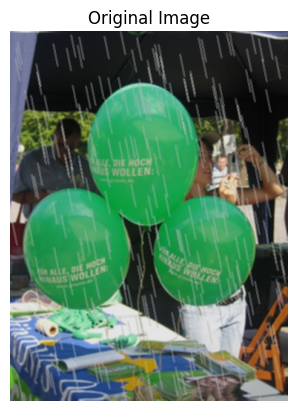

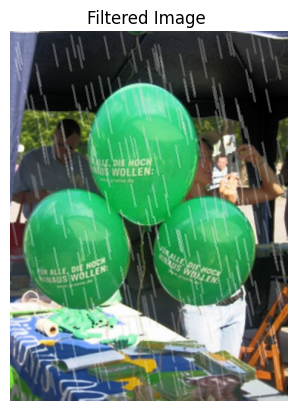


0: 640x480 1 diningtable, 1 person, 28.6ms
Speed: 2.0ms preprocess, 28.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


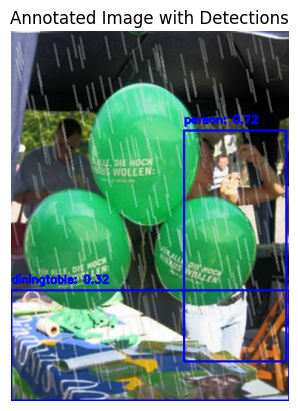

In [ ]:
#Here we are trying to execute all the models ut together (i.e) having the test images pass through the CNN model followed by filters and finally object detection

import os
import torch
from PIL import Image
import torchvision.transforms as transforms
import yaml
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

weather_model = WeatherCNN(num_classes=len(class_names)).to(device)
weather_model.load_state_dict(torch.load('/content/drive/MyDrive/AI-P-checkpoint/cnn_weather_classifier.pth'))
weather_model.eval()

yolo_model = YOLO('/content/drive/MyDrive/AI-P-checkpoint/yolov8_weather_model.pt') #We load the saved and trained YOLO model

with open('/content/drive/MyDrive/Data/images/dataset.yaml') as file: # We load the YOLO class names from the dataset YAML file
    data = yaml.safe_load(file)
    class_names_yolo = data['names']

transform = transforms.Compose([    # Here we define the preprocessing steps for the weather classifier
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def process_image(image_path):
    # Load and display the original image
    original_image = Image.open(image_path).convert('RGB')
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('off')
    plt.show()

    input_image = transform(original_image).unsqueeze(0).to(device) # Here we preprocess and classify the weather condition of the image
    with torch.no_grad():
        weather_output = weather_model(input_image)
        weather_class = torch.argmax(weather_output, dim=1).item()
        weather_class_name = class_names[weather_class]

    image_np = np.array(original_image) #Based on the weather class the filter is applied
    filtered_image = apply_dip(image_np, weather_class)
    filtered_image_bgr = cv2.cvtColor(filtered_image, cv2.COLOR_RGB2BGR)

    # Display the filtered image
    plt.imshow(cv2.cvtColor(filtered_image_bgr, cv2.COLOR_BGR2RGB))
    plt.title(f'Filtered Image ')
    plt.axis('off')
    plt.show()

    yolo_results = yolo_model.predict(filtered_image_bgr, conf=0.25) # Performing object detection on the the filtered image

    for result in yolo_results:  # Annotate detected objects on the image
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            confidence = box.conf[0]
            class_id = int(box.cls[0])
            class_name_yolo = class_names_yolo[class_id] if class_id < len(class_names_yolo) else "Unknown"
            label = f'{class_name_yolo}: {confidence:.2f}'
            cv2.rectangle(filtered_image_bgr, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(filtered_image_bgr, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Display the annotated image
    plt.imshow(cv2.cvtColor(filtered_image_bgr, cv2.COLOR_BGR2RGB))
    plt.title('Annotated Image with Detections')
    plt.axis('off')
    plt.show()

test_folder_path = '/content/drive/MyDrive/test' #Path to the folder containing the test images

for image_name in os.listdir(test_folder_path):
    image_path = os.path.join(test_folder_path, image_name)
    if image_name.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
        print(f'Processing {image_path}...')
        process_image(image_path)

In [ ]:
!pip freeze > requirements.txt

In [ ]:
#This block of code was used to generate the Confusion matrix of the CNN model for term paper purpose
import torch
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
import numpy as np

def evaluate(weather_model, test_loader, class_names):
    # Set model to evaluation mode
    weather_model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            # Move data to the appropriate device
            inputs, labels = inputs.to(device), labels.to(device)

            # Get the model predictions
            outputs = weather_model(inputs)
            _, preds = torch.max(outputs, 1)

            # Append the predictions and labels for later analysis
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())


            batch_indices = list(range(inputs.size(0)))
            for j, index in enumerate(batch_indices):
                image_name = test_loader.dataset.samples[index][0].split('/')[-1]
                predicted_class = class_names[preds[j].item()]


    # Convert the predictions and labels to numpy arrays
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)

    # Plot the confusion matrix
    cm = confusion_matrix(all_labels, all_preds, labels=range(len(class_names)))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap=plt.cm.Blues)
    plt.title("Confusion Matrix")
    plt.show()

    # Print the classification report
    report = classification_report(all_labels, all_preds, target_names=class_names)
    print(report)


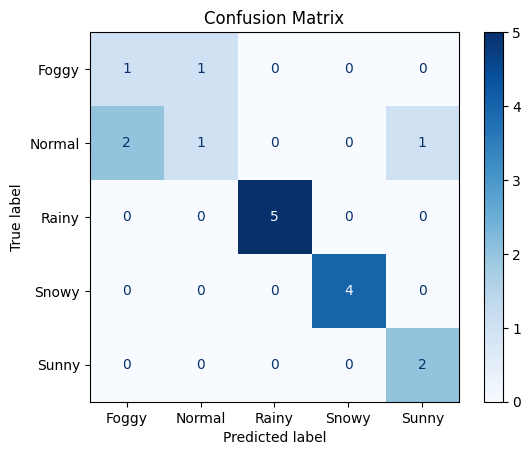

              precision    recall  f1-score   support

       Foggy       0.33      0.50      0.40         2
      Normal       0.50      0.25      0.33         4
       Rainy       1.00      1.00      1.00         5
       Snowy       1.00      1.00      1.00         4
       Sunny       0.67      1.00      0.80         2

    accuracy                           0.76        17
   macro avg       0.70      0.75      0.71        17
weighted avg       0.76      0.76      0.75        17



In [ ]:
test_accuracy = evaluate(weather_model, test_loader, class_names)